# Import library

In [1]:
import os
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import random as rn
from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical

In [2]:
# Lấy ra các loại hoa có trong folder flower
list_flower = os.listdir('flowers')
list_flower

['daisy', 'dandelion', 'rose', 'sunflower', 'tulip']

# Tạo dữ liệu huấn luyện



In [2]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

Daisy_path = 'flowers\\daisy'
Dandelion_path = 'flowers\\dandelion'
Rose_path = 'flowers\\rose'
Sunflower_path = 'flowers\\sunflower'
Tulip_path = 'flowers\\tulip'


# Lấy ra từng ảnh loại hoa

X_array_img = [] # Danh sách ma trận điểm ảnh
Z_label_img = [] # Danh sách chưa nhãn của ảnh

# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_train_test_data_img(flower_type, path_folder_flower):
    X_type_flower = []
    Y_type_flower = []
    for img in os.listdir(path_folder_flower):
        #Lấy ra các tên loại hoa flower_type, img ảnh có ở file
        label = assign_label(img, flower_type)
        
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Z_label_img.append(str(label)) # Lấy ra tên loại hoa tương ứng với ảnh
        
        X_type_flower.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Y_type_flower.append(str(label))
    print('Số lượng loại hoa', flower_type, 'huấn luyện là: ', len(X_type_flower))

# Lấy ra số lượng hoa từng loại
make_train_test_data_img('daisy',Daisy_path)
make_train_test_data_img('dandelion',Dandelion_path)
make_train_test_data_img('rose',Rose_path)
make_train_test_data_img('sunflower',Sunflower_path)
make_train_test_data_img('tulip',Tulip_path)

print('Tổng số lượng các loại hoa huấn luyện: ', len(X_array_img))
print('Nhãn hoa của từng ảnh huấn luyện: ',Z_label_img)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y = le.fit_transform(Z_label_img) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y = to_categorical(Y, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X = np.array(X_array_img) # ma trận điểm ảnh của từng ảnh
X = X/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào huấn luyện: ', X)
print('Nhãn huấn luyện: ', Y)

Số lượng loại hoa daisy huấn luyện là:  408
Số lượng loại hoa dandelion huấn luyện là:  808
Số lượng loại hoa rose huấn luyện là:  568
Số lượng loại hoa sunflower huấn luyện là:  542
Số lượng loại hoa tulip huấn luyện là:  848
Tổng số lượng các loại hoa huấn luyện:  3174
Nhãn hoa của từng ảnh huấn luyện:  ['daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy',

# Tạo dữ liệu kiểm thử

In [3]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

Daisy_test_path = 'flowers_test\\daisy'
Dandelion_test_path = 'flowers_test\\dandelion'
Rose_test_path = 'flowers_test\\rose'
Sunflower_test_path = 'flowers_test\\sunflower'
Tulip_test_path = 'flowers_test\\tulip'


# Lấy ra từng ảnh loại hoa

X_test_array_img = [] # Danh sách ma trận điểm ảnh
Z_test_label_img = [] # Danh sách chưa nhãn của ảnh

# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_train_test_data_img(flower_type, path_folder_flower):
    X_type_flower = []
    Y_type_flower = []
    for img in os.listdir(path_folder_flower):
        #Lấy ra các tên loại hoa flower_type, img ảnh có ở file
        label = assign_label(img, flower_type)
        
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_test_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Z_test_label_img.append(str(label)) # Lấy ra tên loại hoa tương ứng với ảnh
        
        X_type_flower.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Y_type_flower.append(str(label))
    print('Số lượng loại hoa', flower_type, 'kiểm thử là: ', len(X_type_flower))

# Lấy ra số lượng hoa từng loại
make_train_test_data_img('daisy',Daisy_test_path)
make_train_test_data_img('dandelion',Dandelion_test_path)
make_train_test_data_img('rose',Rose_test_path)
make_train_test_data_img('sunflower',Sunflower_test_path)
make_train_test_data_img('tulip',Tulip_test_path)

print('Tổng số lượng các loại hoa kiểm thử: ', len(X_test_array_img))
print('Nhãn hoa của từng ảnh kiểm thử: ',Z_test_label_img)

# Dữ liệu ma trận Kiểm thử (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_test = le.fit_transform(Z_test_label_img) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_test = to_categorical(Y_test, 5) # Phân ra 5 loại hoa -> đưa Y_test ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X_test = np.array(X_test_array_img) # ma trận điểm ảnh của từng ảnh
X_test = X_test/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X_test: data đầu vào
#Y_test: nhãn label
print('Đầu vào kiểm thử: ', X_test)
print('Nhãn kiểm thử: ', Y_test)

Số lượng loại hoa daisy kiểm thử là:  356
Số lượng loại hoa dandelion kiểm thử là:  244
Số lượng loại hoa rose kiểm thử là:  216
Số lượng loại hoa sunflower kiểm thử là:  181
Số lượng loại hoa tulip kiểm thử là:  136
Tổng số lượng các loại hoa kiểm thử:  1133
Nhãn hoa của từng ảnh kiểm thử:  ['daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'dai

# Model

In [4]:
from keras.models import Sequential
from keras.layers import Dense
from keras.optimizers import Adam


# specifically for cnn
from keras.layers import Flatten,Activation
from keras.layers import Conv2D, MaxPooling2D, Dropout

giải thích lớp FLatten
Thao tác làm phẳng trên tensor định hình lại tensor để có hình dạng bằng với số phần tử có trong tensor không bao gồm kích thước lô .
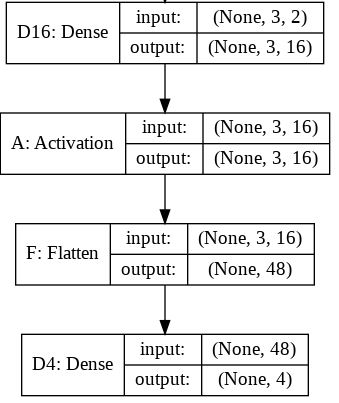

# Mô hình CNN
Chạy thử từng epoch 1-20

In [27]:
dict_epoch_val_accuracy = {}
for epoch in range (1,21):
    model = Sequential()

    # add layer
    model.add(Conv2D(filters= 32, kernel_size=(3,3), input_shape = (128,128,3))) # kích thước 128-128 với số kênh màu =3 #32 bộ lọc, kích thước 1 bộ lọc (5x5)
    model.add(MaxPooling2D(pool_size=(2,2)))

    model.add(Conv2D(filters = 64, kernel_size = (3,3)))
    model.add(MaxPooling2D(pool_size=(4,4)))


    model.add(Conv2D(filters = 64, kernel_size = (3,3)))
    model.add(MaxPooling2D(pool_size=(4,4)))

    model.add(Flatten())
    # Fully connected

    model.add(Dense(512)) # fully connected lớp kết nối đầy đủ
    model.add(Activation('sigmoid'))
    model.add(Dropout(0.5))
    model.add(Dense(5, activation = "softmax")) # Output layer

    # thông số
    model.compile(optimizer=Adam(lr=0.001),loss='categorical_crossentropy',metrics=['accuracy']) #lr: kearning rate = 0.001
    # categorical_crossentropy: một hàm mất mát được sử dụng trong các bài toán phân loại đa lớp, đầu ra được mã hóa dưới dạng one-hot vector

    model.summary() # Tổng hợp mô hình


    History = model.fit(X, Y, batch_size = 40, epochs=epoch, validation_data=(X_test, Y_test)) # số lượng mẫu 1 batch_size = 40, 
    # thực hiện kiểm thử trên dữ liệu test luôn: validation_data: kết quả của việc kiểm tra lại các dữ liệu đã học
    dict_epoch_val_accuracy[epoch] = History.history['val_accuracy']
print('Val_accuracy từng epoch là: ', dict_epoch_val_accuracy)


Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_57 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_57 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_58 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_58 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_59 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_59 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_60 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_60 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_61 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_61 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_62 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_62 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_63 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_63 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_64 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_64 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_65 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_65 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_66 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_66 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_67 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_67 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_68 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_68 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_69 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_69 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_70 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_70 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_71 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_71 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_72 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_72 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_73 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_73 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_74 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_74 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_75 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_75 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_76 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_76 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_77 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_77 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_78 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_78 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_79 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_79 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_80 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_80 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_81 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_81 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_82 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_82 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_83 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_83 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_84 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_84 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_85 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_85 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_86 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_86 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_87 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_87 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_88 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_88 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_89 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_89 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_90 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_90 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_91 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_91 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_92 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_92 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_93 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_93 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_94 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_94 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_95 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_95 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_96 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_96 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_97 (Conv2D)          (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_97 (MaxPooli  (None, 15, 15, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_98 (Conv2D)          (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_98 (MaxPooli  (None, 3, 3, 64)        

Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_99 (Conv2D)          (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_99 (MaxPooli  (None, 63, 63, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_100 (Conv2D)         (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_100 (MaxPool  (None, 15, 15, 64)        0         
 ing2D)                                                          
                                                                 
 conv2d_101 (Conv2D)         (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_101 (MaxPool  (None, 3, 3, 64)        

Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_102 (Conv2D)         (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_102 (MaxPool  (None, 63, 63, 32)        0         
 ing2D)                                                          
                                                                 
 conv2d_103 (Conv2D)         (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_103 (MaxPool  (None, 15, 15, 64)        0         
 ing2D)                                                          
                                                                 
 conv2d_104 (Conv2D)         (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_104 (MaxPool  (None, 3, 3, 64)        

Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_105 (Conv2D)         (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_105 (MaxPool  (None, 63, 63, 32)        0         
 ing2D)                                                          
                                                                 
 conv2d_106 (Conv2D)         (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_106 (MaxPool  (None, 15, 15, 64)        0         
 ing2D)                                                          
                                                                 
 conv2d_107 (Conv2D)         (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_107 (MaxPool  (None, 3, 3, 64)        

Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_108 (Conv2D)         (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_108 (MaxPool  (None, 63, 63, 32)        0         
 ing2D)                                                          
                                                                 
 conv2d_109 (Conv2D)         (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_109 (MaxPool  (None, 15, 15, 64)        0         
 ing2D)                                                          
                                                                 
 conv2d_110 (Conv2D)         (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_110 (MaxPool  (None, 3, 3, 64)        

Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_111 (Conv2D)         (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_111 (MaxPool  (None, 63, 63, 32)        0         
 ing2D)                                                          
                                                                 
 conv2d_112 (Conv2D)         (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_112 (MaxPool  (None, 15, 15, 64)        0         
 ing2D)                                                          
                                                                 
 conv2d_113 (Conv2D)         (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_113 (MaxPool  (None, 3, 3, 64)        

Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_114 (Conv2D)         (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d_114 (MaxPool  (None, 63, 63, 32)        0         
 ing2D)                                                          
                                                                 
 conv2d_115 (Conv2D)         (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_115 (MaxPool  (None, 15, 15, 64)        0         
 ing2D)                                                          
                                                                 
 conv2d_116 (Conv2D)         (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_116 (MaxPool  (None, 3, 3, 64)        

In [34]:
print('Độ chính xác trên tệp kiểm thử (Val_accuracy):\n ',History.history['val_accuracy'])
print('Độ chính xác lớn nhất của kiểm thử (Val_accuracy): ',max(History.history['val_accuracy']))
print('Epoch có Độ chính xác lớn nhất của kiểm thử (Val_accuracy): ',History.history['val_accuracy'].index(max(History.history['val_accuracy'])))

Độ chính xác trên tệp kiểm thử (Val_accuracy):
  [0.5330979824066162, 0.5948808193206787, 0.5957634449005127, 0.5710502862930298, 0.6257722973823547, 0.6310679316520691, 0.633715808391571, 0.6646072268486023, 0.6125330924987793, 0.685789942741394, 0.658428966999054, 0.6425419449806213, 0.6690202951431274, 0.6875551342964172, 0.6619594097137451, 0.6716681122779846, 0.658428966999054, 0.6504854559898376, 0.6496028304100037, 0.6601941585540771]
Độ chính xác lớn nhất của kiểm thử (Val_accuracy):  0.6875551342964172
Epoch có Độ chính xác lớn nhất của kiểm thử (Val_accuracy):  13


In [255]:
x = [0.5330979824066162,0.5948808193206787, 0.5957634449005127, 0.5710502862930298, 0.6257722973823547, 0.6310679316520691, 0.633715808391571, 0.6646072268486023, 0.6125330924987793, 0.685789942741394, 0.658428966999054, 0.6425419449806213, 0.6690202951431274, 0.6875551342964172, 0.6619594097137451, 0.6716681122779846, 0.658428966999054, 0.6504854559898376, 0.6496028304100037, 0.6601941585540771]
y = []
for i in x: 
    i = np.around(i,2)
    y.append(i)
print(y)


[0.53, 0.59, 0.6, 0.57, 0.63, 0.63, 0.63, 0.66, 0.61, 0.69, 0.66, 0.64, 0.67, 0.69, 0.66, 0.67, 0.66, 0.65, 0.65, 0.66]


# Epoch Max = 13
Sau 20 lần chạy epoch, mô hình sử dụng epoch = 13 có giá trị validation accuracy lớn nhất


In [5]:
epoch = 13

model = Sequential()
# add layer
model.add(Conv2D(filters= 32, kernel_size=(3,3), input_shape = (128,128,3))) # kích thước 128-128 với số kênh màu =3 #32 bộ lọc, kích thước 1 bộ lọc (5x5)
model.add(MaxPooling2D(pool_size=(2,2)))

model.add(Conv2D(filters = 64, kernel_size = (3,3)))
model.add(MaxPooling2D(pool_size=(4,4)))


model.add(Conv2D(filters = 64, kernel_size = (3,3)))
model.add(MaxPooling2D(pool_size=(4,4)))

model.add(Flatten())
# Fully connected

model.add(Dense(512)) # fully connected lớp kết nối đầy đủ
model.add(Activation('sigmoid'))
model.add(Dropout(0.5))
model.add(Dense(5, activation = "softmax")) # Output layer

# thông số
model.compile(optimizer=Adam(lr=0.001),loss='categorical_crossentropy',metrics=['accuracy']) #lr: kearning rate = 0.001
# categorical_crossentropy: một hàm mất mát được sử dụng trong các bài toán phân loại đa lớp, đầu ra được mã hóa dưới dạng one-hot vector

model.summary() # Tổng hợp mô hình


History = model.fit(X, Y, batch_size = 40, epochs=epoch, validation_data=(X_test, Y_test)) # số lượng mẫu 1 batch_size = 40, 

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 126, 126, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 63, 63, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 61, 61, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 15, 15, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 13, 13, 64)        36928     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 3, 3, 64)          0

# Kết quả các trọng số sau khi huấn luyện


Trọng số lớp cuối cùng

In [6]:
list_weight = model.layers[-1].get_weights()[0]
print('Số lượng trọng số W sau khi kết thúc huấn luyện: ', len(list_weight))
print('Trọng số W sau khi kết thúc huấn luyện: \n', list_weight)


Số lượng trọng số W sau khi kết thúc huấn luyện:  512
Trọng số W sau khi kết thúc huấn luyện: 
 [[-0.0126219  -0.07394745  0.05518513 -0.08154093 -0.0557191 ]
 [-0.04466635  0.0355775   0.03085728 -0.14140444 -0.00549633]
 [ 0.03766254  0.03981265 -0.04871089 -0.10969586  0.00649499]
 ...
 [ 0.00119597  0.11652769 -0.04657085  0.01908868 -0.08674333]
 [-0.02753283  0.06723393  0.00897169  0.00630991 -0.10796535]
 [ 0.0596054   0.0537406   0.00500337  0.1273292   0.02062243]]


In [8]:
list_bias = model.layers[-1].get_weights()[1]
print('Số lượng trọng số Bias sau khi kết thúc huấn luyện: ', len(list_bias))
print('Trọng số bias sau khi kết thúc huấn luyện: ', list_bias)

Số lượng trọng số Bias sau khi kết thúc huấn luyện:  5
Trọng số bias sau khi kết thúc huấn luyện:  [ 0.00114727 -0.00481508  0.00765598 -0.00390054 -0.00130498]


# Giải thích các thông số:
- loss: 1.2595 - accuracy: 0.4646 - val_loss: 1.0825 - val_accuracy: 0.5861
- loss: giá trị hàm mất mát trên tập huấn luyện.
- accuracy: độ chính xác trên tập huấn luyện.
- val_loss: giá trị hàm mất mát trên tập kiểm tra.
- val_accuracy: độ chính xác trên tập kiểm tra.

# Kiểm thử dữ liệu huấn luyện


# 10 ảnh đẹp huấn luyện

In [20]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

Daisy_path_train_dep = '10 anh train\\daisy_dep'
Dandelion_path_train_dep = '10 anh train\\dandelion_dep'
Rose_path_train_dep = '10 anh train\\rose_dep'
Sunflower_path_train_dep = '10 anh train\\sunflower_dep'
Tulip_path_train_dep = '10 anh train\\tulip_dep'


# Lấy ra từng ảnh loại hoa

X_train_dep_array_img = [] # Danh sách ma trận điểm ảnh
Z_train_dep_label_img = [] # Danh sách chưa nhãn của ảnh

# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_train_train_data_img(flower_type, path_folder_flower):
    X_type_flower = []
    Y_type_flower = []
    for img in os.listdir(path_folder_flower):
        #Lấy ra các tên loại hoa flower_type, img ảnh có ở file
        label = assign_label(img, flower_type)
        
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_train_dep_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Z_train_dep_label_img.append(str(label)) # Lấy ra tên loại hoa tương ứng với ảnh
        
        X_type_flower.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Y_type_flower.append(str(label))
    print('Số lượng loại hoa', flower_type, 'thực tế là: ', len(X_type_flower))

# Lấy ra số lượng hoa từng loại
make_train_train_data_img('daisy',Daisy_path_train_dep)
make_train_train_data_img('dandelion',Dandelion_path_train_dep)
make_train_train_data_img('rose',Rose_path_train_dep)
make_train_train_data_img('sunflower',Sunflower_path_train_dep)
make_train_train_data_img('tulip',Tulip_path_train_dep)

print('Tổng số lượng các loại hoa đẹp kiểm thử huấn luyện: ', len(X_train_dep_array_img))
print('Nhãn hoa của từng ảnh : ',Z_train_dep_label_img)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_train_dep = le.fit_transform(Z_train_dep_label_img) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_train_dep = to_categorical(Y_train_dep, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X_train_dep = np.array(X_train_dep_array_img) # ma trận điểm ảnh của từng ảnh
X_train_dep = X_train_dep/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào thực tế: ', X_train_dep)
print('Nhãn thực tế: ', Y_train_dep)



Số lượng loại hoa daisy thực tế là:  10
Số lượng loại hoa dandelion thực tế là:  10
Số lượng loại hoa rose thực tế là:  10
Số lượng loại hoa sunflower thực tế là:  10
Số lượng loại hoa tulip thực tế là:  10
Tổng số lượng các loại hoa đẹp kiểm thử huấn luyện:  50
Nhãn hoa của từng ảnh :  ['daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip']
Đầu vào thực tế:  [[[[0.18431373 0.16470588 0.16862745]
   [0.03921569 0.08627451 0.04705882]
   [0.03137255 0.07058824 0.04313725]
   ...
   [0.28235294 0.31764706 0.2745098 ]
   [0.36862745

In [21]:
# Kiểm thử lại với tệp dữ liệu huấn luyện
y_pre_train_dep = model.predict(X_train_dep)
predict_train_dep = np.argmax(y_pre_train_dep, axis=1) # trả về vị trí có giá trị max - loại hoa tại ảnh đó
# y_train
flower_pre_train_dep = []
for i in predict_train_dep:
    if i == 0:
        flower_pre_train_dep.append('daisy')
    elif i == 1:
        flower_pre_train_dep.append('dandelion')
    elif i == 2:
        flower_pre_train_dep.append('rose')
    elif i == 3:
        flower_pre_train_dep.append('sunflower')
    else:
        flower_pre_train_dep.append('tulip')
# Sai số CE khi kiểm thử dữ liệu thực tế

# Chuyển Z_train_label_img về số nguyên
Z_train_dep_num = []
for i in Z_train_dep_label_img:
    if i == 'daisy':
        Z_train_dep_num.append(0)
    if i == 'dandelion':
        Z_train_dep_num.append(1)
    if i == 'rose':
        Z_train_dep_num.append(2)
    if i == 'sunflower':
        Z_train_dep_num.append(3)
    if i == 'tulip':
        Z_train_dep_num.append(4)
print(Z_train_dep_num)
s_ce = 0
for j in range(0, 10):
    s_ce += -np.log(y_pre_train_dep[j][Z_train_dep_num[j]])*1
print('Sai số CE mô hình dữ liệu đẹp huấn luyện: ', s_ce/100)



2/2 [==============================] - 0s 130ms/step
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Sai số CE mô hình dữ liệu đẹp huấn luyện:  0.014984284695237875


# Daisy Train

-------------------------------------------10 ảnh daisy đẹp Train đầu vào---------------------------------------------------------


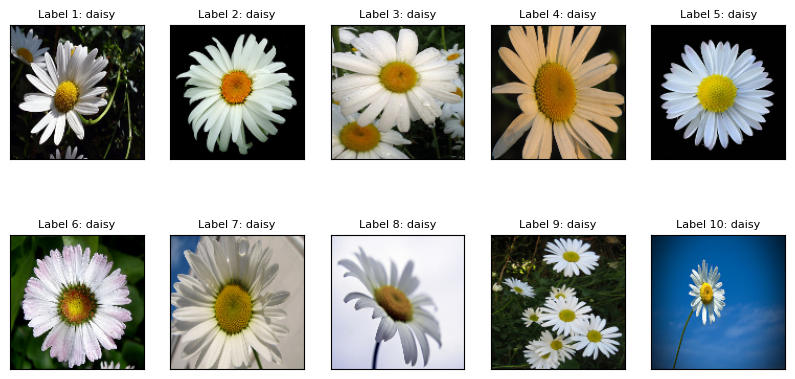

-------------------------------------------------10 ảnh daisy đẹp Train dự đoán-------------------------------------------------------


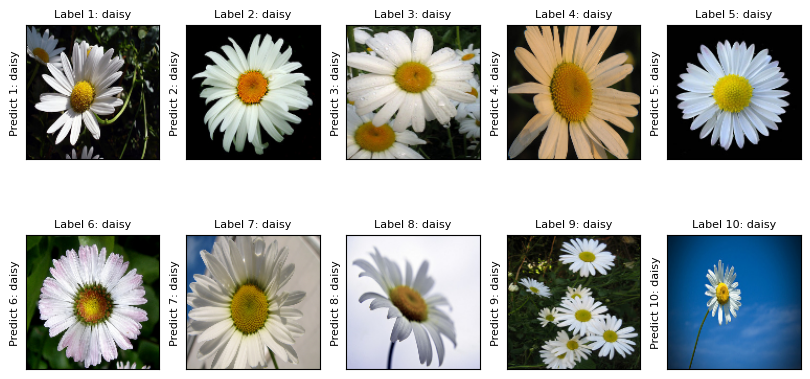

Kết quả dự đoán 10 hình daisy đẹp Train
Độ chính xác dự đoán hoa daisy của 10 hình đẹp Train:  100.0 %


In [22]:
fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_dep_label_img.index('daisy')
Z_train_dep_label_daisy = Z_train_dep_label_img[index_type:10]

y_pre_train_dep_daisy = []
print('-------------------------------------------10 ảnh daisy đẹp Train đầu vào---------------------------------------------------------')
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_train_dep_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()

#### predict
print('-------------------------------------------------10 ảnh daisy đẹp Train dự đoán-------------------------------------------------------')
fig = plt.figure(figsize=(10, 5))

y_pre_train_dep_daisy = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_train_dep_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_dep_image = flower_pre_train_dep[i-1]
    y_pre_train_dep_daisy.append(y_pre_train_dep_image)
    plt.ylabel('Predict {}: {}'.format(i, y_pre_train_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình daisy đẹp Train')
accuracy_daisy = 0
for i in range (0, 10):
    if Z_train_dep_label_daisy[i] == y_pre_train_dep_daisy[i]:
        accuracy_daisy += 1
accuracy_daisy = accuracy_daisy/len(Z_train_dep_label_daisy)*100
print('Độ chính xác dự đoán hoa daisy của 10 hình đẹp Train: ', accuracy_daisy, '%')



# Dandelion Train

-------------------------------------------10 ảnh dandelion đẹp huấn luyện đầu vào---------------------------------------------------------


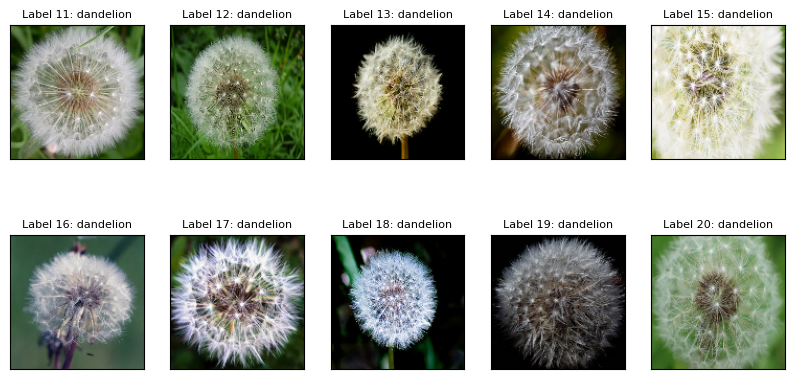

-------------------------------------------10 ảnh dandelion đẹp huấn luyện dự đoán---------------------------------------------------------


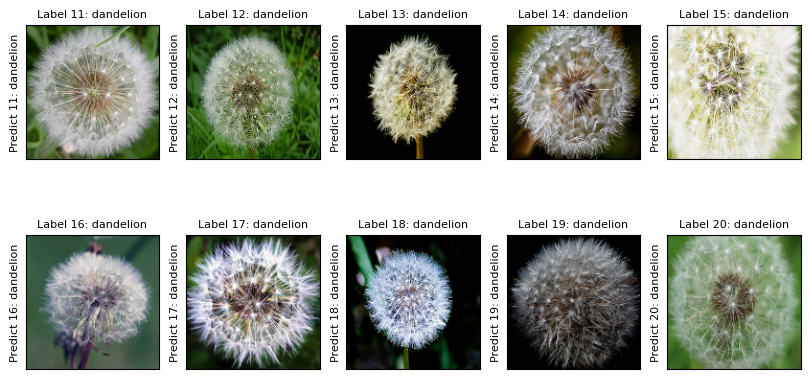

Kết quả dự đoán 10 hình dandelion đẹp Train
Độ chính xác dự đoán hoa dandelion của 10 hình đẹp Train:  100.0 %


In [23]:


fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_dep_label_img.index('dandelion')
Z_train_dep_label_dandelion = Z_train_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh dandelion đẹp huấn luyện đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh dandelion đẹp huấn luyện dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_train_dep_dandelion = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_dep_image = flower_pre_train_dep[i-1+index_type]
    y_pre_train_dep_dandelion.append(y_pre_train_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_train_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình dandelion đẹp Train')
accuracy_dandelion = 0
for i in range (0, len(Z_train_dep_label_dandelion)):
    if Z_train_dep_label_dandelion[i] == y_pre_train_dep_dandelion[i]:
        accuracy_dandelion += 1
accuracy_dandelion = accuracy_dandelion/len(Z_train_dep_label_dandelion)*100
print('Độ chính xác dự đoán hoa dandelion của 10 hình đẹp Train: ', accuracy_dandelion, '%')





# Rose Train

-------------------------------------------10 ảnh rose đẹp huấn luyện đầu vào---------------------------------------------------------


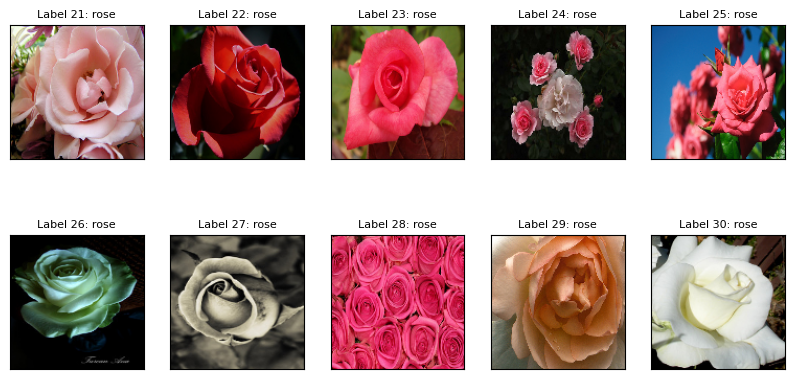

-------------------------------------------10 ảnh rose đẹp huấn luyện dự đoán---------------------------------------------------------


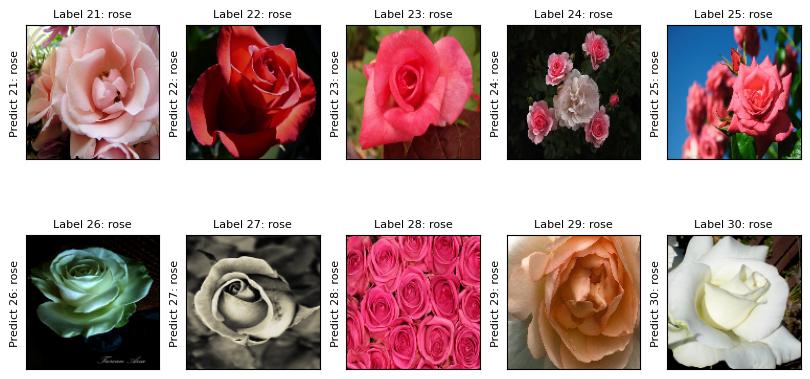

Kết quả dự đoán 10 hình rose đẹp Train
Độ chính xác dự đoán hoa rose của 10 hình đẹp Train:  100.0 %


In [24]:
fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_dep_label_img.index('rose')
Z_train_dep_label_rose = Z_train_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh rose đẹp huấn luyện đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh rose đẹp huấn luyện dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_train_dep_rose = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_dep_image = flower_pre_train_dep[i-1+index_type]
    y_pre_train_dep_rose.append(y_pre_train_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_train_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình rose đẹp Train')
accuracy_rose = 0
for i in range (0, len(Z_train_dep_label_rose)):
    if Z_train_dep_label_rose[i] == y_pre_train_dep_rose[i]:
        accuracy_rose += 1
accuracy_rose = accuracy_rose/len(Z_train_dep_label_rose)*100
print('Độ chính xác dự đoán hoa rose của 10 hình đẹp Train: ', accuracy_rose, '%')



# Sunflower Train

-------------------------------------------10 ảnh sunflower đẹp huấn luyện đầu vào---------------------------------------------------------


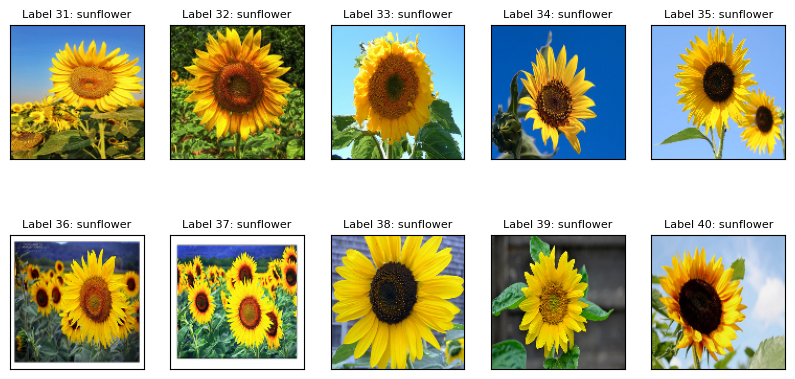

-------------------------------------------10 ảnh sunflower đẹp huấn luyện dự đoán---------------------------------------------------------


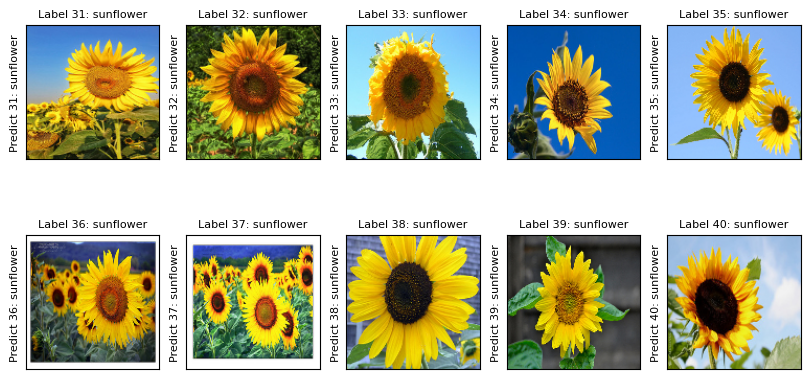

Kết quả dự đoán 10 hình sunflower đẹp Train
Độ chính xác dự đoán hoa sunflower của 10 hình đẹp Train:  100.0 %


In [25]:



fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_dep_label_img.index('sunflower')
Z_train_dep_label_sunflower = Z_train_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh sunflower đẹp huấn luyện đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh sunflower đẹp huấn luyện dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_train_dep_sunflower = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_dep_image = flower_pre_train_dep[i-1+index_type]
    y_pre_train_dep_sunflower.append(y_pre_train_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_train_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình sunflower đẹp Train')
accuracy_sunflower = 0
for i in range (0, len(Z_train_dep_label_sunflower)):
    if Z_train_dep_label_sunflower[i] == y_pre_train_dep_sunflower[i]:
        accuracy_sunflower += 1
accuracy_sunflower = accuracy_sunflower/len(Z_train_dep_label_sunflower)*100
print('Độ chính xác dự đoán hoa sunflower của 10 hình đẹp Train: ', accuracy_sunflower, '%')


# Tulip Train

-------------------------------------------10 ảnh tulip đẹp huấn luyện đầu vào---------------------------------------------------------


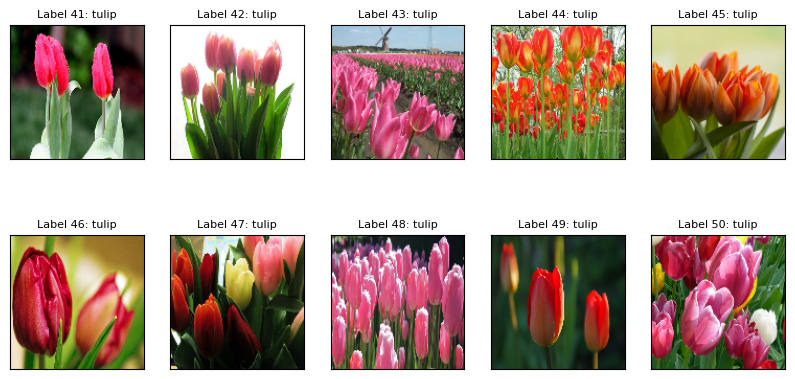

-------------------------------------------10 ảnh tulip đẹp huấn luyện dự đoán---------------------------------------------------------


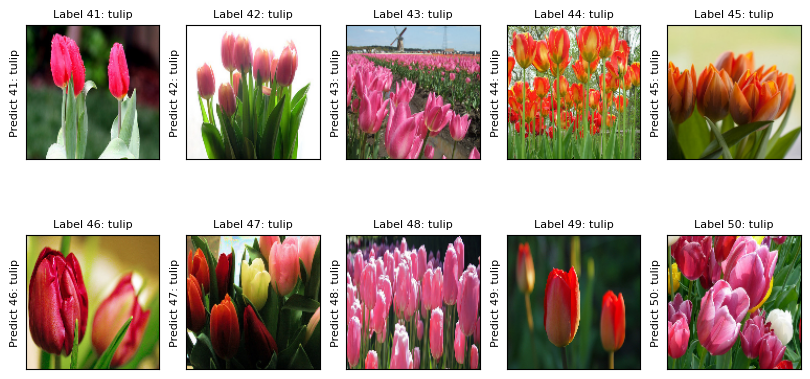

Kết quả dự đoán 10 hình tulip đẹp Train
Độ chính xác dự đoán hoa tulip của 10 hình đẹp Train:  100.0 %


In [26]:



fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_dep_label_img.index('tulip')
Z_train_dep_label_tulip = Z_train_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh tulip đẹp huấn luyện đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh tulip đẹp huấn luyện dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_train_dep_tulip = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_dep_image = flower_pre_train_dep[i-1+index_type]
    y_pre_train_dep_tulip.append(y_pre_train_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_train_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình tulip đẹp Train')
accuracy_tulip = 0
for i in range (0, len(Z_train_dep_label_tulip)):
    if Z_train_dep_label_tulip[i] == y_pre_train_dep_tulip[i]:
        accuracy_tulip += 1
accuracy_tulip = accuracy_tulip/len(Z_train_dep_label_tulip)*100
print('Độ chính xác dự đoán hoa tulip của 10 hình đẹp Train: ', accuracy_tulip, '%')



# 10 ảnh xấu huấn luyện

chuan bi du lieu

In [27]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

Daisy_path_train_xau = '10 anh train\\daisy_xau'
Dandelion_path_train_xau = '10 anh train\\dandelion_xau'
Rose_path_train_xau = '10 anh train\\rose_xau'
Sunflower_path_train_xau = '10 anh train\\sunflower_xau'
Tulip_path_train_xau = '10 anh train\\tulip_xau'


# Lấy ra từng ảnh loại hoa

X_train_xau_array_img = [] # Danh sách ma trận điểm ảnh
Z_train_xau_label_img = [] # Danh sách chưa nhãn của ảnh

# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_train_train_data_img(flower_type, path_folder_flower):
    X_type_flower = []
    Y_type_flower = []
    for img in os.listdir(path_folder_flower):
        #Lấy ra các tên loại hoa flower_type, img ảnh có ở file
        label = assign_label(img, flower_type)
        
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_train_xau_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Z_train_xau_label_img.append(str(label)) # Lấy ra tên loại hoa tương ứng với ảnh
        
        X_type_flower.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Y_type_flower.append(str(label))
    print('Số lượng loại hoa', flower_type, 'huấn luyện xấu là: ', len(X_type_flower))

# Lấy ra số lượng hoa từng loại
make_train_train_data_img('daisy',Daisy_path_train_xau)
make_train_train_data_img('dandelion',Dandelion_path_train_xau)
make_train_train_data_img('rose',Rose_path_train_xau)
make_train_train_data_img('sunflower',Sunflower_path_train_xau)
make_train_train_data_img('tulip',Tulip_path_train_xau)

print('Tổng số lượng các loại hoa huấn luyện xấu: ', len(X_train_xau_array_img))
print('Nhãn hoa của từng ảnh: ',Z_train_xau_label_img)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_train_xau = le.fit_transform(Z_train_xau_label_img) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_train_xau = to_categorical(Y_train_xau, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X_train_xau = np.array(X_train_xau_array_img) # ma trận điểm ảnh của từng ảnh
X_train_xau = X_train_xau/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào huấn luyện xấu: ', X_train_xau)
print('Nhãn thực tế: ', Y_train_xau)




Số lượng loại hoa daisy huấn luyện xấu là:  10


Số lượng loại hoa dandelion huấn luyện xấu là:  10
Số lượng loại hoa rose huấn luyện xấu là:  10
Số lượng loại hoa sunflower huấn luyện xấu là:  10
Số lượng loại hoa tulip huấn luyện xấu là:  10
Tổng số lượng các loại hoa huấn luyện xấu:  50
Nhãn hoa của từng ảnh:  ['daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip']
Đầu vào huấn luyện xấu:  [[[[0.00392157 0.00392157 0.00392157]
   [0.00784314 0.00784314 0.00784314]
   [0.00392157 0.00392157 0.00392157]
   ...
   [0.         0.00784314 0.00784314]
   [0.         0.00392157 0.0

In [28]:

# Kiểm thử lại với tệp dữ liệu huấn luyện
y_pre_train_xau = model.predict(X_train_xau)
predict_train_xau = np.argmax(y_pre_train_xau, axis=1) # trả về vị trí có giá trị max - loại hoa tại ảnh đó
# y_train
flower_pre_train_xau = []
for i in predict_train_xau:
    if i == 0:
        flower_pre_train_xau.append('daisy')
    elif i == 1:
        flower_pre_train_xau.append('dandelion')
    elif i == 2:
        flower_pre_train_xau.append('rose')
    elif i == 3:
        flower_pre_train_xau.append('sunflower')
    else:
        flower_pre_train_xau.append('tulip')
# Sai số CE khi kiểm thử dữ liệu thực tế

# Chuyển Z_train_label_img về số nguyên
Z_train_xau_num = []
for i in Z_train_xau_label_img:
    if i == 'daisy':
        Z_train_xau_num.append(0)
    if i == 'dandelion':
        Z_train_xau_num.append(1)
    if i == 'rose':
        Z_train_xau_num.append(2)
    if i == 'sunflower':
        Z_train_xau_num.append(3)
    if i == 'tulip':
        Z_train_xau_num.append(4)
print(Z_train_xau_num)
s_ce = 0
for j in range(0, 10):
    s_ce += -np.log(y_pre_train_xau[j][Z_train_xau_num[j]])*1
print('Sai số CE mô hình dữ liệu Train xau: ', s_ce/100)




2/2 [==============================] - 0s 138ms/step
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Sai số CE mô hình dữ liệu Train xau:  0.09676716737449169


# Daisy Train

-------------------------------------------10 ảnh daisy xấu Train đầu vào---------------------------------------------------------


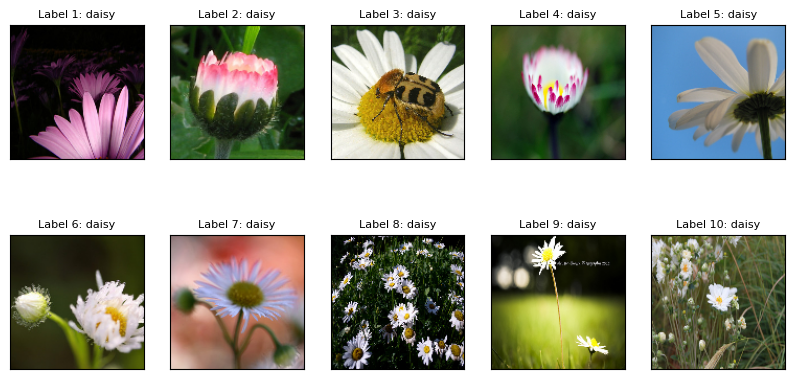

-------------------------------------------------10 ảnh daisy xấu Train dự đoán-------------------------------------------------------


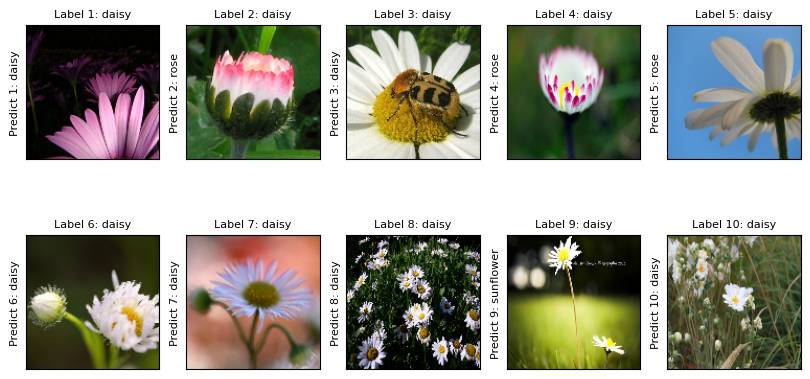

Kết quả dự đoán 10 hình daisy xau Train
Độ chính xác dự đoán hoa daisy của 10 hình xau Train:  60.0 %


In [29]:


fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_xau_label_img.index('daisy')
Z_train_xau_label_daisy = Z_train_xau_label_img[index_type:10]

y_pre_train_xau_daisy = []
print('-------------------------------------------10 ảnh daisy xấu Train đầu vào---------------------------------------------------------')
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_train_xau_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()

#### predict
print('-------------------------------------------------10 ảnh daisy xấu Train dự đoán-------------------------------------------------------')
fig = plt.figure(figsize=(10, 5))

y_pre_train_xau_daisy = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_train_xau_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_xau_image = flower_pre_train_xau[i-1]
    y_pre_train_xau_daisy.append(y_pre_train_xau_image)
    plt.ylabel('Predict {}: {}'.format(i, y_pre_train_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình daisy xau Train')
accuracy_daisy = 0
for i in range (0, 10):
    if Z_train_xau_label_daisy[i] == y_pre_train_xau_daisy[i]:
        accuracy_daisy += 1
accuracy_daisy = accuracy_daisy/len(Z_train_xau_label_daisy)*100
print('Độ chính xác dự đoán hoa daisy của 10 hình xau Train: ', accuracy_daisy, '%')





# Dandelion Train

-------------------------------------------10 ảnh dandelion xấu huấn luyện đầu vào---------------------------------------------------------


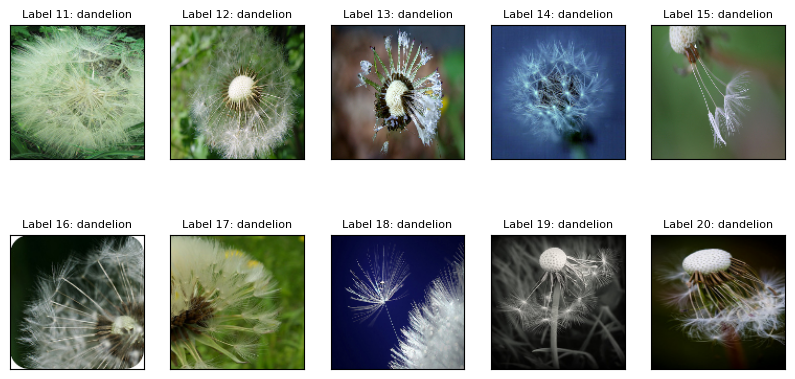

-------------------------------------------10 ảnh dandelion xấu huấn luyện dự đoán---------------------------------------------------------


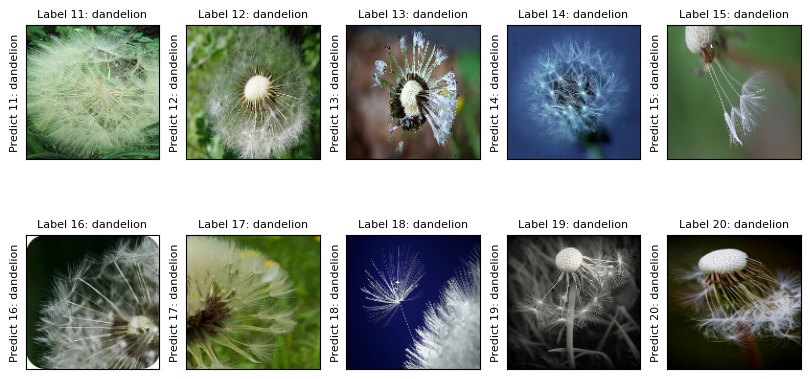

Kết quả dự đoán 10 hình dandelion xấu Train
Độ chính xác dự đoán hoa dandelion của 10 hình xấu Train:  100.0 %


In [30]:


fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_xau_label_img.index('dandelion')
Z_train_xau_label_dandelion = Z_train_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh dandelion xấu huấn luyện đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh dandelion xấu huấn luyện dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_train_xau_dandelion = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_xau_image = flower_pre_train_xau[i-1+index_type]
    y_pre_train_xau_dandelion.append(y_pre_train_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_train_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình dandelion xấu Train')
accuracy_dandelion = 0
for i in range (0, len(Z_train_xau_label_dandelion)):
    if Z_train_xau_label_dandelion[i] == y_pre_train_xau_dandelion[i]:
        accuracy_dandelion += 1
accuracy_dandelion = accuracy_dandelion/len(Z_train_xau_label_dandelion)*100
print('Độ chính xác dự đoán hoa dandelion của 10 hình xấu Train: ', accuracy_dandelion, '%')



# Rose Train

-------------------------------------------10 ảnh rose xấu huấn luyện đầu vào---------------------------------------------------------


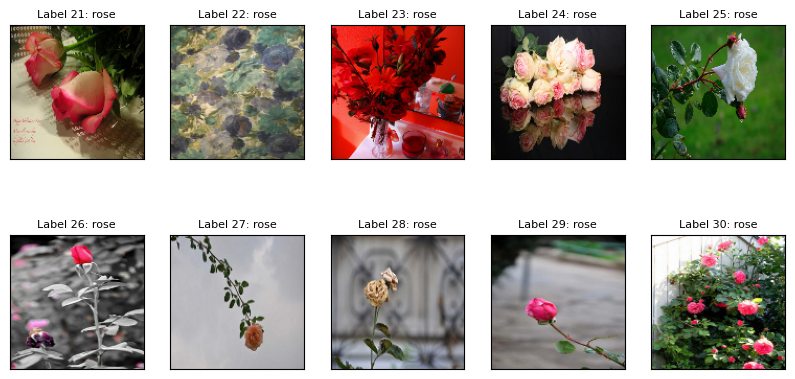

-------------------------------------------10 ảnh rose xấu huấn luyện dự đoán---------------------------------------------------------


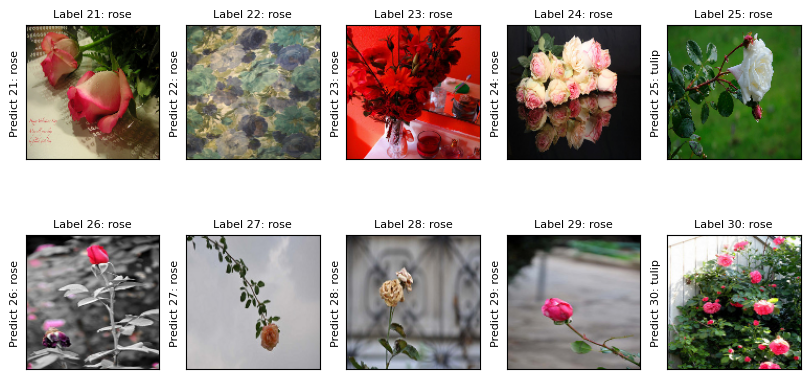

Kết quả dự đoán 10 hình rose xấu Train
Độ chính xác dự đoán hoa rose của 10 hình xấu Train:  80.0 %


In [31]:

fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_xau_label_img.index('rose')
Z_train_xau_label_rose = Z_train_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh rose xấu huấn luyện đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh rose xấu huấn luyện dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_train_xau_rose = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_xau_image = flower_pre_train_xau[i-1+index_type]
    y_pre_train_xau_rose.append(y_pre_train_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_train_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình rose xấu Train')
accuracy_rose = 0
for i in range (0, len(Z_train_xau_label_rose)):
    if Z_train_xau_label_rose[i] == y_pre_train_xau_rose[i]:
        accuracy_rose += 1
accuracy_rose = accuracy_rose/len(Z_train_xau_label_rose)*100
print('Độ chính xác dự đoán hoa rose của 10 hình xấu Train: ', accuracy_rose, '%')



# Sunflower


-------------------------------------------10 ảnh sunflower xấu đầu vào---------------------------------------------------------


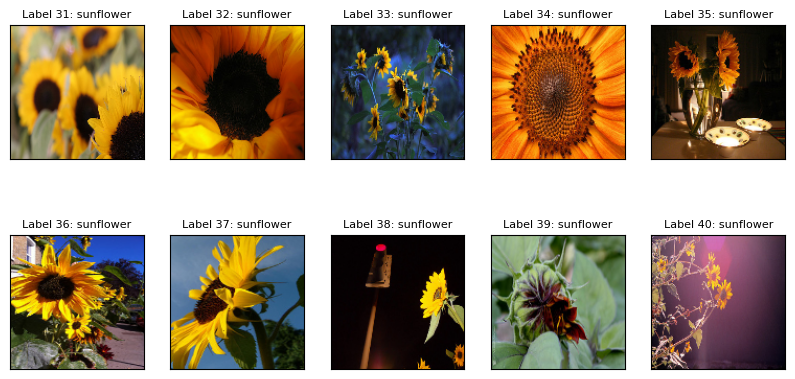

-------------------------------------------10 ảnh sunflower xấu dự đoán---------------------------------------------------------


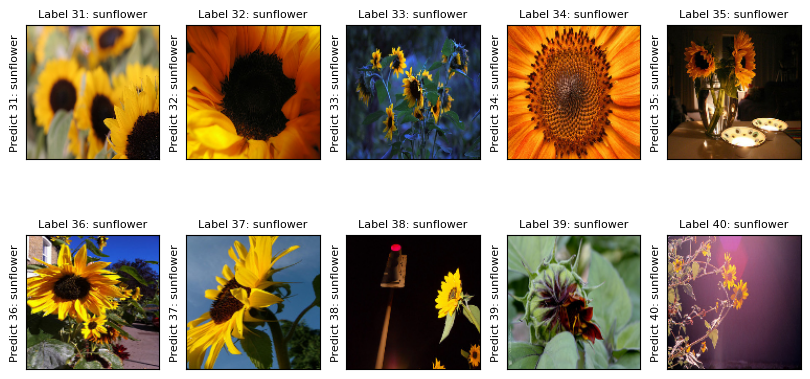

Kết quả dự đoán 10 hình sunflower xấu Train
Độ chính xác dự đoán hoa sunflower của 10 hình xấu Train:  100.0 %


In [32]:



fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_xau_label_img.index('sunflower')
Z_train_xau_label_sunflower = Z_train_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh sunflower xấu đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh sunflower xấu dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_train_xau_sunflower = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_xau_image = flower_pre_train_xau[i-1+index_type]
    y_pre_train_xau_sunflower.append(y_pre_train_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_train_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình sunflower xấu Train')
accuracy_sunflower = 0
for i in range (0, len(Z_train_xau_label_sunflower)):
    if Z_train_xau_label_sunflower[i] == y_pre_train_xau_sunflower[i]:
        accuracy_sunflower += 1
accuracy_sunflower = accuracy_sunflower/len(Z_train_xau_label_sunflower)*100
print('Độ chính xác dự đoán hoa sunflower của 10 hình xấu Train: ', accuracy_sunflower, '%')



# Tulip

-------------------------------------------10 ảnh tulip xấu huấn luyện đầu vào---------------------------------------------------------


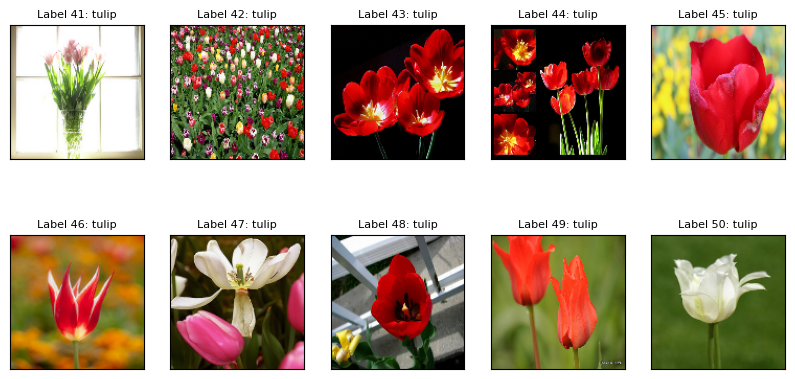

-------------------------------------------10 ảnh tulip đẹp xấu huấn luyện dự đoán---------------------------------------------------------


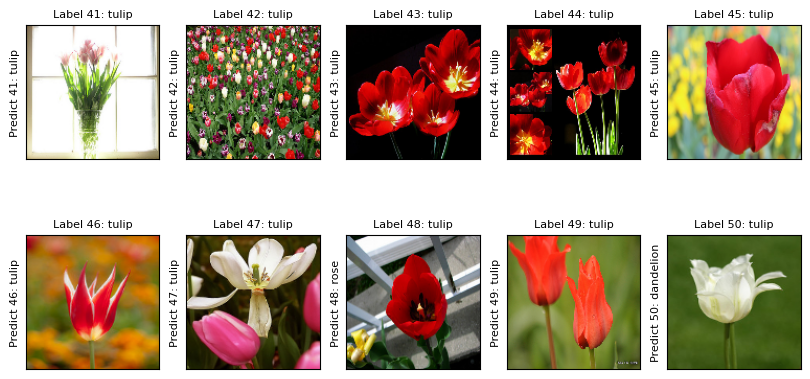

Kết quả dự đoán 10 hình tulip xấu Train
Độ chính xác dự đoán hoa tulip của 10 hình xấu Train:  80.0 %


In [33]:

fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_train_xau_label_img.index('tulip')
Z_train_xau_label_tulip = Z_train_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh tulip xấu huấn luyện đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh tulip đẹp xấu huấn luyện dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_train_xau_tulip = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_train_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_train_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_train_xau_image = flower_pre_train_xau[i-1+index_type]
    y_pre_train_xau_tulip.append(y_pre_train_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_train_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình tulip xấu Train')
accuracy_tulip = 0
for i in range (0, len(Z_train_xau_label_tulip)):
    if Z_train_xau_label_tulip[i] == y_pre_train_xau_tulip[i]:
        accuracy_tulip += 1
accuracy_tulip = accuracy_tulip/len(Z_train_xau_label_tulip)*100
print('Độ chính xác dự đoán hoa tulip của 10 hình xấu Train: ', accuracy_tulip, '%')


# Kiểm thử dữ liệu kiểm thử

chuan bi du lieu

# 10 anh test đẹp

In [34]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

Daisy_path_test_dep = '10 anh test\\daisy dep'
Dandelion_path_test_dep = '10 anh test\\dandelion dep'
Rose_path_test_dep = '10 anh test\\rose dep'
Sunflower_path_test_dep = '10 anh test\\sunflower dep'
Tulip_path_test_dep = '10 anh test\\tulip dep'


# Lấy ra từng ảnh loại hoa

X_test_dep_array_img = [] # Danh sách ma trận điểm ảnh
Z_test_dep_label_img = [] # Danh sách chưa nhãn của ảnh

# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_train_test_data_img(flower_type, path_folder_flower):
    X_type_flower = []
    Y_type_flower = []
    for img in os.listdir(path_folder_flower):
        #Lấy ra các tên loại hoa flower_type, img ảnh có ở file
        label = assign_label(img, flower_type)
        
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_test_dep_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Z_test_dep_label_img.append(str(label)) # Lấy ra tên loại hoa tương ứng với ảnh
        
        X_type_flower.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Y_type_flower.append(str(label))
    print('Số lượng loại hoa', flower_type, 'thực tế là: ', len(X_type_flower))

# Lấy ra số lượng hoa từng loại
make_train_test_data_img('daisy',Daisy_path_test_dep)
make_train_test_data_img('dandelion',Dandelion_path_test_dep)
make_train_test_data_img('rose',Rose_path_test_dep)
make_train_test_data_img('sunflower',Sunflower_path_test_dep)
make_train_test_data_img('tulip',Tulip_path_test_dep)

print('Tổng số lượng các loại hoa kiểm thử đẹp: ', len(X_test_dep_array_img))
print('Nhãn hoa của từng ảnh kiểm thử đẹp: ',Z_test_dep_label_img)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_test_dep = le.fit_transform(Z_test_dep_label_img) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_test_dep = to_categorical(Y_test_dep, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X_test_dep = np.array(X_test_dep_array_img) # ma trận điểm ảnh của từng ảnh
X_test_dep = X_test_dep/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào kiểm thử đẹp: ', X_test_dep)
print('Nhãn thực tế: ', Y_test_dep)


Số lượng loại hoa daisy thực tế là:  10
Số lượng loại hoa dandelion thực tế là:  10
Số lượng loại hoa rose thực tế là:  10
Số lượng loại hoa sunflower thực tế là:  10
Số lượng loại hoa tulip thực tế là:  10
Tổng số lượng các loại hoa kiểm thử đẹp:  50
Nhãn hoa của từng ảnh kiểm thử đẹp:  ['daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip']
Đầu vào kiểm thử đẹp:  [[[[0.4        0.65882353 0.61960784]
   [0.25490196 0.53333333 0.49019608]
   [0.2        0.45490196 0.43137255]
   ...
   [0.24313725 0.45882353 0.40784314]
   [0.24

# Daisy Test

In [35]:
# Kiểm thử lại với tệp dữ liệu huấn luyện
y_pre_test_dep = model.predict(X_test_dep)
predict_test_dep = np.argmax(y_pre_test_dep, axis=1) # trả về vị trí có giá trị max - loại hoa tại ảnh đó
# y_test
flower_pre_test_dep = []
for i in predict_test_dep:
    if i == 0:
        flower_pre_test_dep.append('daisy')
    elif i == 1:
        flower_pre_test_dep.append('dandelion')
    elif i == 2:
        flower_pre_test_dep.append('rose')
    elif i == 3:
        flower_pre_test_dep.append('sunflower')
    else:
        flower_pre_test_dep.append('tulip')
# Sai số CE khi kiểm thử dữ liệu thực tế

# Chuyển Z_test_label_img về số nguyên
Z_test_dep_num = []
for i in Z_test_dep_label_img:
    if i == 'daisy':
        Z_test_dep_num.append(0)
    if i == 'dandelion':
        Z_test_dep_num.append(1)
    if i == 'rose':
        Z_test_dep_num.append(2)
    if i == 'sunflower':
        Z_test_dep_num.append(3)
    if i == 'tulip':
        Z_test_dep_num.append(4)
print(Z_test_dep_num)
s_ce = 0
for j in range(0, 10):
    s_ce += -np.log(y_pre_test_dep[j][Z_test_dep_num[j]])*1
print('Sai số CE mô hình dữ liệu kiểm thử đẹp: ', s_ce/100)


2/2 [==============================] - 0s 127ms/step
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Sai số CE mô hình dữ liệu kiểm thử đẹp:  0.004652072989847511


-------------------------------------------10 ảnh daisy đẹp Test đầu vào---------------------------------------------------------


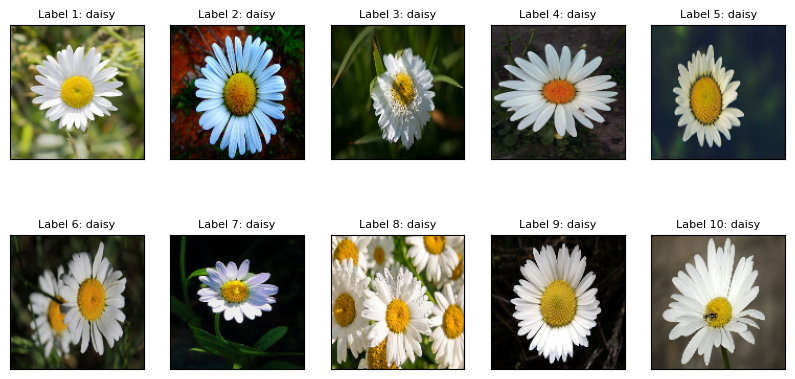

-------------------------------------------------10 ảnh daisy đẹp Test dự đoán-------------------------------------------------------


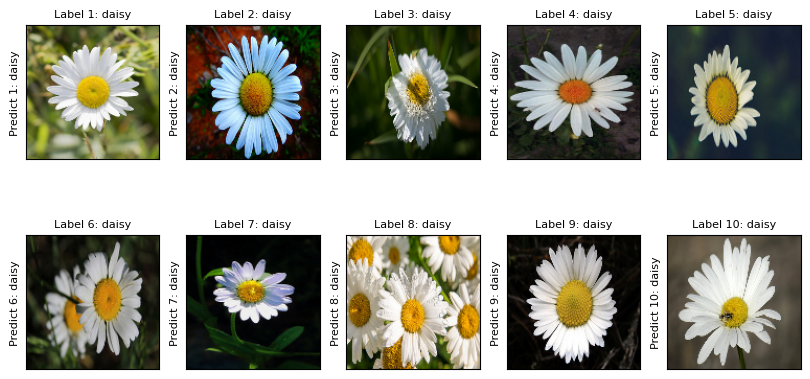

Kết quả dự đoán 10 hình daisy đẹp Test
Độ chính xác dự đoán hoa daisy của 10 hình đẹp Test:  100.0 %


In [36]:
fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_dep_label_img.index('daisy')
Z_test_dep_label_daisy = Z_test_dep_label_img[index_type:10]

y_pre_test_dep_daisy = []
print('-------------------------------------------10 ảnh daisy đẹp Test đầu vào---------------------------------------------------------')
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_test_dep_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()

#### predict
print('-------------------------------------------------10 ảnh daisy đẹp Test dự đoán-------------------------------------------------------')
fig = plt.figure(figsize=(10, 5))

y_pre_test_dep_daisy = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_test_dep_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_dep_image = flower_pre_test_dep[i-1]
    y_pre_test_dep_daisy.append(y_pre_test_dep_image)
    plt.ylabel('Predict {}: {}'.format(i, y_pre_test_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình daisy đẹp Test')
accuracy_daisy = 0
for i in range (0, 10):
    if Z_test_dep_label_daisy[i] == y_pre_test_dep_daisy[i]:
        accuracy_daisy += 1
accuracy_daisy = accuracy_daisy/len(Z_test_dep_label_daisy)*100
print('Độ chính xác dự đoán hoa daisy của 10 hình đẹp Test: ', accuracy_daisy, '%')


# Dandelion Test

-------------------------------------------10 ảnh dandelion đẹp đẹp Test đầu vào---------------------------------------------------------


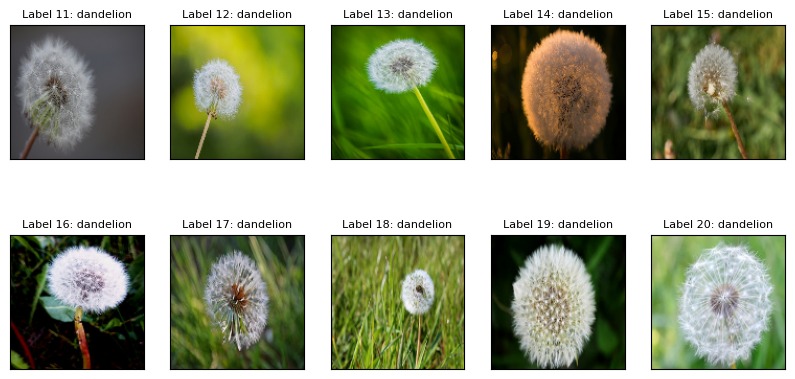

-------------------------------------------10 ảnh dandelion đẹp Test dự đoán---------------------------------------------------------


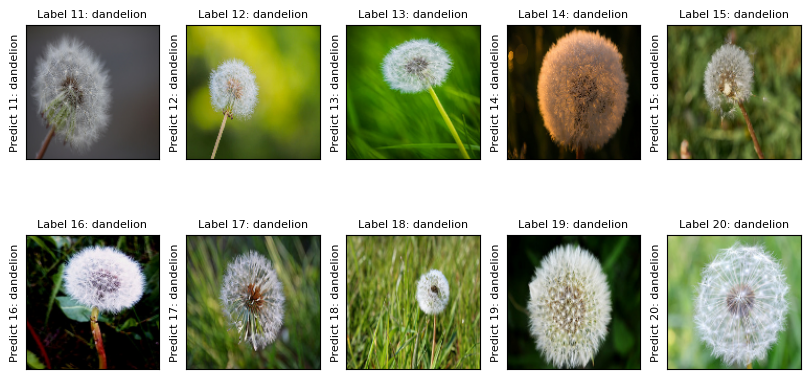

Kết quả dự đoán 10 hình dandelion đẹp Test
Độ chính xác dự đoán hoa dandelion của 10 hình đẹp Test:  100.0 %


In [37]:


fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_dep_label_img.index('dandelion')
Z_test_dep_label_dandelion = Z_test_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh dandelion đẹp đẹp Test đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh dandelion đẹp Test dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_test_dep_dandelion = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_dep_image = flower_pre_test_dep[i-1+index_type]
    y_pre_test_dep_dandelion.append(y_pre_test_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_test_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình dandelion đẹp Test')
accuracy_dandelion = 0
for i in range (0, len(Z_test_dep_label_dandelion)):
    if Z_test_dep_label_dandelion[i] == y_pre_test_dep_dandelion[i]:
        accuracy_dandelion += 1
accuracy_dandelion = accuracy_dandelion/len(Z_test_dep_label_dandelion)*100
print('Độ chính xác dự đoán hoa dandelion của 10 hình đẹp Test: ', accuracy_dandelion, '%')




# Rose Test

-------------------------------------------10 ảnh rose đẹp test đầu vào---------------------------------------------------------


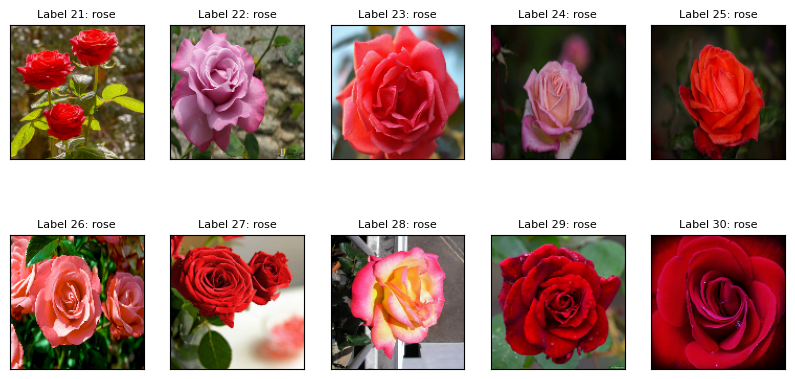

-------------------------------------------10 ảnh rose đẹp test dự đoán---------------------------------------------------------


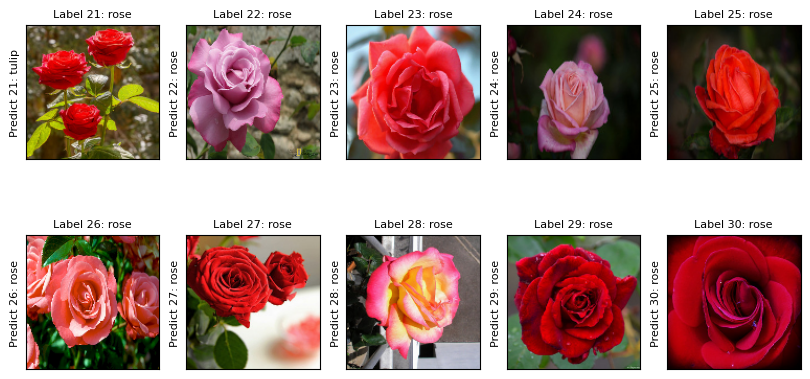

Kết quả dự đoán 10 hình rose đẹp Test
Độ chính xác dự đoán hoa rose của 10 hình đẹp Test:  90.0 %


In [38]:



fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_dep_label_img.index('rose')
Z_test_dep_label_rose = Z_test_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh rose đẹp test đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh rose đẹp test dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_test_dep_rose = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_dep_image = flower_pre_test_dep[i-1+index_type]
    y_pre_test_dep_rose.append(y_pre_test_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_test_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình rose đẹp Test')
accuracy_rose = 0
for i in range (0, len(Z_test_dep_label_rose)):
    if Z_test_dep_label_rose[i] == y_pre_test_dep_rose[i]:
        accuracy_rose += 1
accuracy_rose = accuracy_rose/len(Z_test_dep_label_rose)*100
print('Độ chính xác dự đoán hoa rose của 10 hình đẹp Test: ', accuracy_rose, '%')






# Sunflower Test

-------------------------------------------10 ảnh sunflower đẹp test đầu vào---------------------------------------------------------


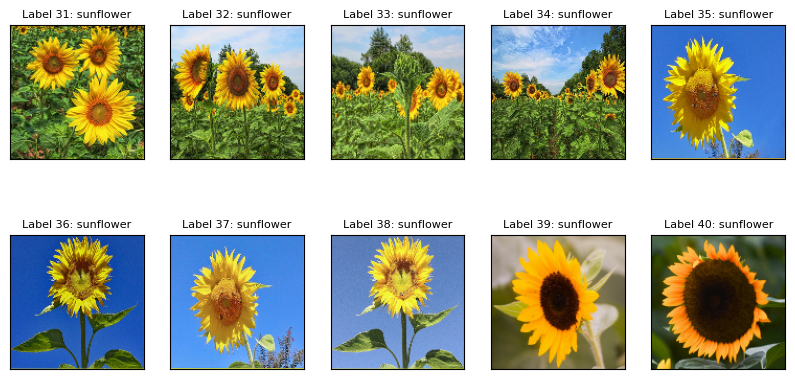

-------------------------------------------10 ảnh sunflower đẹp test dự đoán---------------------------------------------------------


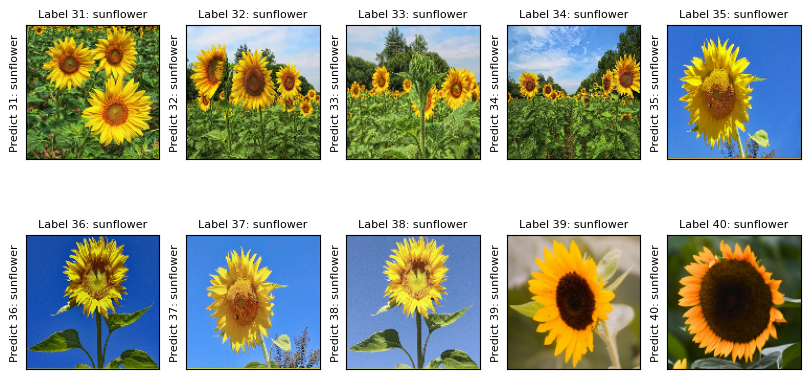

Kết quả dự đoán 10 hình sunflower đẹp Test
Độ chính xác dự đoán hoa sunflower của 10 hình đẹp Test:  100.0 %


In [39]:



fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_dep_label_img.index('sunflower')
Z_test_dep_label_sunflower = Z_test_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh sunflower đẹp test đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh sunflower đẹp test dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_test_dep_sunflower = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_dep_image = flower_pre_test_dep[i-1+index_type]
    y_pre_test_dep_sunflower.append(y_pre_test_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_test_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình sunflower đẹp Test')
accuracy_sunflower = 0
for i in range (0, len(Z_test_dep_label_sunflower)):
    if Z_test_dep_label_sunflower[i] == y_pre_test_dep_sunflower[i]:
        accuracy_sunflower += 1
accuracy_sunflower = accuracy_sunflower/len(Z_test_dep_label_sunflower)*100
print('Độ chính xác dự đoán hoa sunflower của 10 hình đẹp Test: ', accuracy_sunflower, '%')






# Tulip Test

-------------------------------------------10 ảnh tulip test đầu vào---------------------------------------------------------


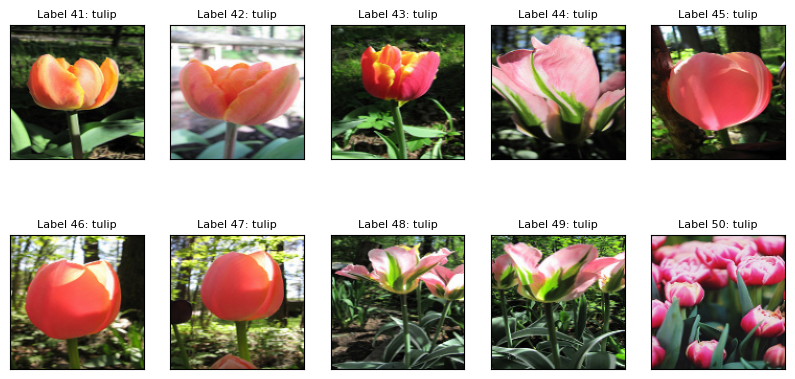

-------------------------------------------10 ảnh tulip test dự đoán---------------------------------------------------------


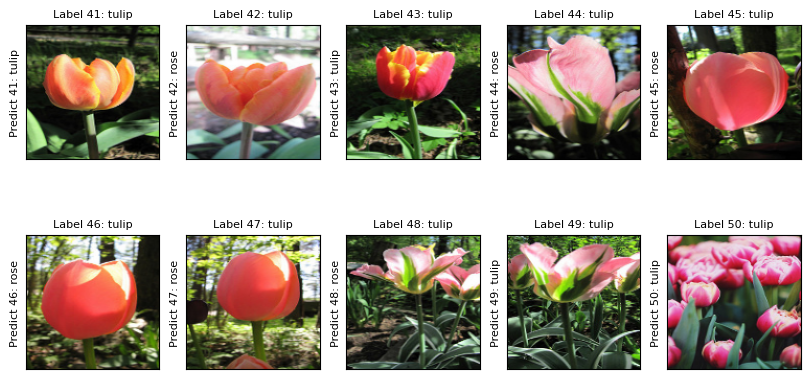

Kết quả dự đoán 10 hình tulip đẹp Test
Độ chính xác dự đoán hoa tulip của 10 hình đẹp Test:  40.0 %


In [40]:



fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_dep_label_img.index('tulip')
Z_test_dep_label_tulip = Z_test_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh tulip test đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh tulip test dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_test_dep_tulip = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_dep_image = flower_pre_test_dep[i-1+index_type]
    y_pre_test_dep_tulip.append(y_pre_test_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_test_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình tulip đẹp Test')
accuracy_tulip = 0
for i in range (0, len(Z_test_dep_label_tulip)):
    if Z_test_dep_label_tulip[i] == y_pre_test_dep_tulip[i]:
        accuracy_tulip += 1
accuracy_tulip = accuracy_tulip/len(Z_test_dep_label_tulip)*100
print('Độ chính xác dự đoán hoa tulip của 10 hình đẹp Test: ', accuracy_tulip, '%')



# 10 anh test xau

In [41]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

Daisy_path_test_xau = '10 anh test\\daisy xau'
Dandelion_path_test_xau = '10 anh test\\dandelion xau'
Rose_path_test_xau = '10 anh test\\rose xau'
Sunflower_path_test_xau = '10 anh test\\sunflower xau'
Tulip_path_test_xau = '10 anh test\\tulip xau'


# Lấy ra từng ảnh loại hoa

X_test_xau_array_img = [] # Danh sách ma trận điểm ảnh
Z_test_xau_label_img = [] # Danh sách chưa nhãn của ảnh

# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_train_test_data_img(flower_type, path_folder_flower):
    X_type_flower = []
    Y_type_flower = []
    for img in os.listdir(path_folder_flower):
        #Lấy ra các tên loại hoa flower_type, img ảnh có ở file
        label = assign_label(img, flower_type)
        
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_test_xau_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Z_test_xau_label_img.append(str(label)) # Lấy ra tên loại hoa tương ứng với ảnh
        
        X_type_flower.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Y_type_flower.append(str(label))
    print('Số lượng loại hoa', flower_type, 'test xấu là: ', len(X_type_flower))

# Lấy ra số lượng hoa từng loại
make_train_test_data_img('daisy',Daisy_path_test_xau)
make_train_test_data_img('dandelion',Dandelion_path_test_xau)
make_train_test_data_img('rose',Rose_path_test_xau)
make_train_test_data_img('sunflower',Sunflower_path_test_xau)
make_train_test_data_img('tulip',Tulip_path_test_xau)

print('Tổng số lượng các loại hoa thực tế: ', len(X_test_xau_array_img))
print('Nhãn hoa của từng ảnh thực tế: ',Z_test_xau_label_img)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_test_xau = le.fit_transform(Z_test_xau_label_img) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_test_xau = to_categorical(Y_test_xau, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X_test_xau = np.array(X_test_xau_array_img) # ma trận điểm ảnh của từng ảnh
X_test_xau = X_test_xau/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào test: ', X_test_xau)
print('Nhãn thực tế: ', Y_test_xau)



Số lượng loại hoa daisy test xấu là:  10
Số lượng loại hoa dandelion test xấu là:  10
Số lượng loại hoa rose test xấu là:  10
Số lượng loại hoa sunflower test xấu là:  10
Số lượng loại hoa tulip test xấu là:  10
Tổng số lượng các loại hoa thực tế:  50
Nhãn hoa của từng ảnh thực tế:  ['daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip']
Đầu vào test:  [[[[0.20784314 0.38431373 0.47843137]
   [0.21568627 0.41176471 0.50196078]
   [0.21568627 0.43137255 0.52941176]
   ...
   [0.97254902 0.95294118 0.94117647]
   [0.97254902 0.9529

In [42]:

# Kiểm thử lại với tệp dữ liệu huấn luyện
y_pre_test_xau = model.predict(X_test_xau)
predict_test_xau = np.argmax(y_pre_test_xau, axis=1) # trả về vị trí có giá trị max - loại hoa tại ảnh đó
# y_test
flower_pre_test_xau = []
for i in predict_test_xau:
    if i == 0:
        flower_pre_test_xau.append('daisy')
    elif i == 1:
        flower_pre_test_xau.append('dandelion')
    elif i == 2:
        flower_pre_test_xau.append('rose')
    elif i == 3:
        flower_pre_test_xau.append('sunflower')
    else:
        flower_pre_test_xau.append('tulip')
# Sai số CE khi kiểm thử dữ liệu thực tế

# Chuyển Z_test_label_img về số nguyên
Z_test_xau_num = []
for i in Z_test_xau_label_img:
    if i == 'daisy':
        Z_test_xau_num.append(0)
    if i == 'dandelion':
        Z_test_xau_num.append(1)
    if i == 'rose':
        Z_test_xau_num.append(2)
    if i == 'sunflower':
        Z_test_xau_num.append(3)
    if i == 'tulip':
        Z_test_xau_num.append(4)
print(Z_test_xau_num)
s_ce = 0
for j in range(0, 10):
    s_ce += -np.log(y_pre_test_xau[j][Z_test_xau_num[j]])*1
print('Sai số CE mô hình dữ liệu Test xau: ', s_ce/100)



1/2 [==============>...............] - ETA: 0s

2/2 [==============================] - 0s 183ms/step
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Sai số CE mô hình dữ liệu Test xau:  0.274637334048748


# Daisy Test

-------------------------------------------10 ảnh daisy xấu Test đầu vào---------------------------------------------------------


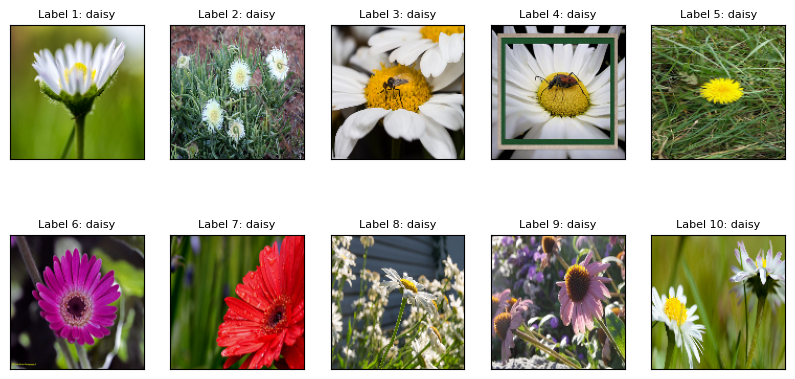

-------------------------------------------------10 ảnh daisy xấu Test dự đoán-------------------------------------------------------


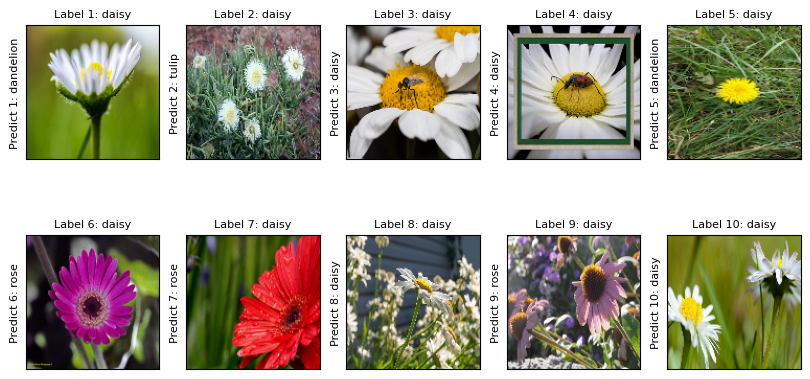

Kết quả dự đoán 10 hình daisy xấu Test
Độ chính xác dự đoán hoa daisy của 10 hình xấu Test:  40.0 %


In [43]:


fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_xau_label_img.index('daisy')
Z_test_xau_label_daisy = Z_test_xau_label_img[index_type:10]

y_pre_test_xau_daisy = []
print('-------------------------------------------10 ảnh daisy xấu Test đầu vào---------------------------------------------------------')
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_xau_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_test_xau_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()

#### predict
print('-------------------------------------------------10 ảnh daisy xấu Test dự đoán-------------------------------------------------------')
fig = plt.figure(figsize=(10, 5))

y_pre_test_xau_daisy = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_xau_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_test_xau_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_xau_image = flower_pre_test_xau[i-1]
    y_pre_test_xau_daisy.append(y_pre_test_xau_image)
    plt.ylabel('Predict {}: {}'.format(i, y_pre_test_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình daisy xấu Test')
accuracy_daisy = 0
for i in range (0, 10):
    if Z_test_xau_label_daisy[i] == y_pre_test_xau_daisy[i]:
        accuracy_daisy += 1
accuracy_daisy = accuracy_daisy/len(Z_test_xau_label_daisy)*100
print('Độ chính xác dự đoán hoa daisy của 10 hình xấu Test: ', accuracy_daisy, '%')




# Dandelion Test

-------------------------------------------10 ảnh dandelion xấu test đầu vào---------------------------------------------------------


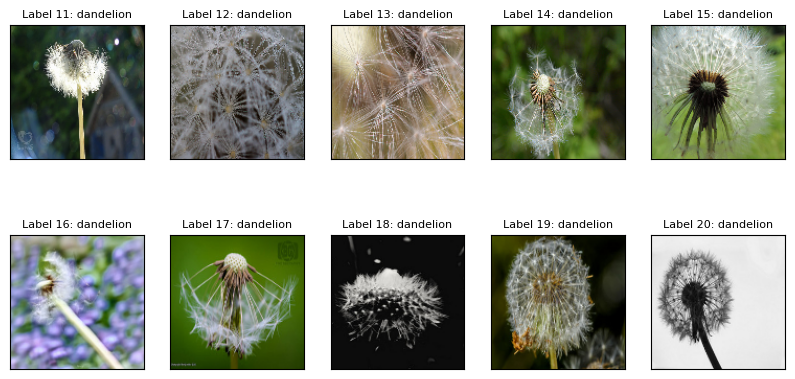

-------------------------------------------10 ảnh dandelion xấu test dự đoán---------------------------------------------------------


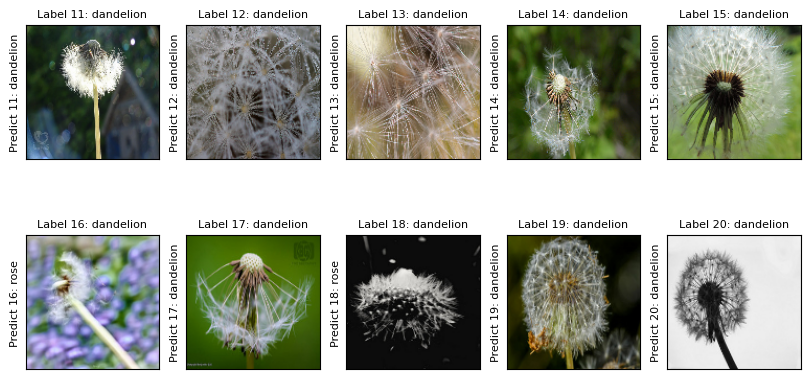

Kết quả dự đoán 10 hình xấu test
Độ chính xác dự đoán hoa dandelion của 10 hình xấu test:  80.0 %


In [44]:




fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_xau_label_img.index('dandelion')
Z_test_xau_label_dandelion = Z_test_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh dandelion xấu test đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh dandelion xấu test dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_test_xau_dandelion = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_xau_image = flower_pre_test_xau[i-1+index_type]
    y_pre_test_xau_dandelion.append(y_pre_test_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_test_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình xấu test')
accuracy_dandelion = 0
for i in range (0, len(Z_test_xau_label_dandelion)):
    if Z_test_xau_label_dandelion[i] == y_pre_test_xau_dandelion[i]:
        accuracy_dandelion += 1
accuracy_dandelion = accuracy_dandelion/len(Z_test_xau_label_dandelion)*100
print('Độ chính xác dự đoán hoa dandelion của 10 hình xấu test: ', accuracy_dandelion, '%')




# Rose Test

-------------------------------------------10 ảnh rose xấu test đầu vào---------------------------------------------------------


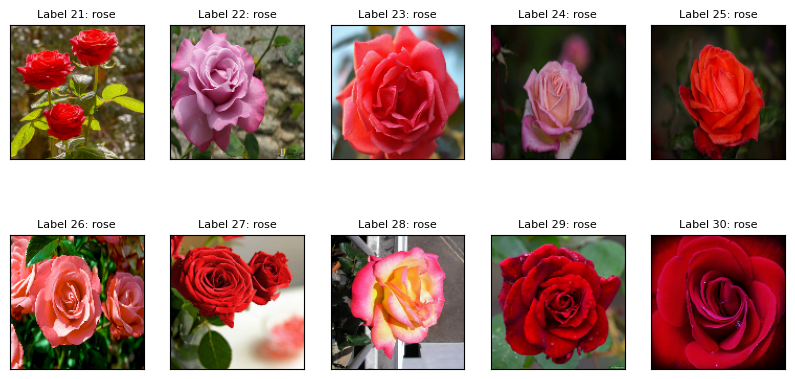

-------------------------------------------10 ảnh rose xấu test dự đoán---------------------------------------------------------


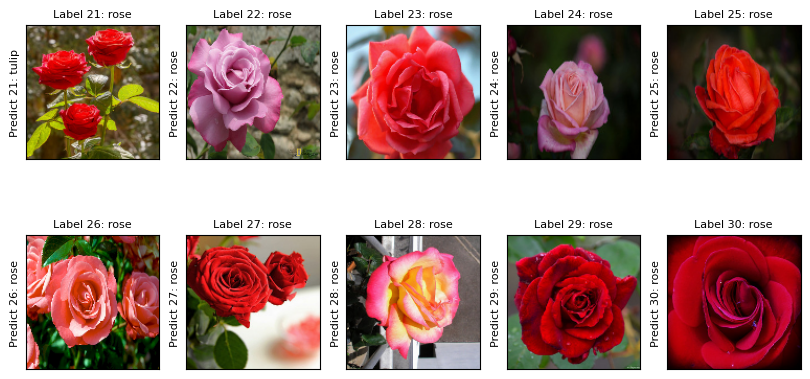

Kết quả dự đoán 10 hình rose xấu test
Độ chính xác dự đoán hoa rose của 10 hình xấu test:  90.0 %


In [45]:




fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_dep_label_img.index('rose')
Z_test_dep_label_rose = Z_test_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh rose xấu test đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh rose xấu test dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_test_dep_rose = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_dep_image = flower_pre_test_dep[i-1+index_type]
    y_pre_test_dep_rose.append(y_pre_test_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_test_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình rose xấu test')
accuracy_rose = 0
for i in range (0, len(Z_test_dep_label_rose)):
    if Z_test_dep_label_rose[i] == y_pre_test_dep_rose[i]:
        accuracy_rose += 1
accuracy_rose = accuracy_rose/len(Z_test_dep_label_rose)*100
print('Độ chính xác dự đoán hoa rose của 10 hình xấu test: ', accuracy_rose, '%')




# Sunflower Test

-------------------------------------------10 ảnh sunflower xấu test đầu vào---------------------------------------------------------


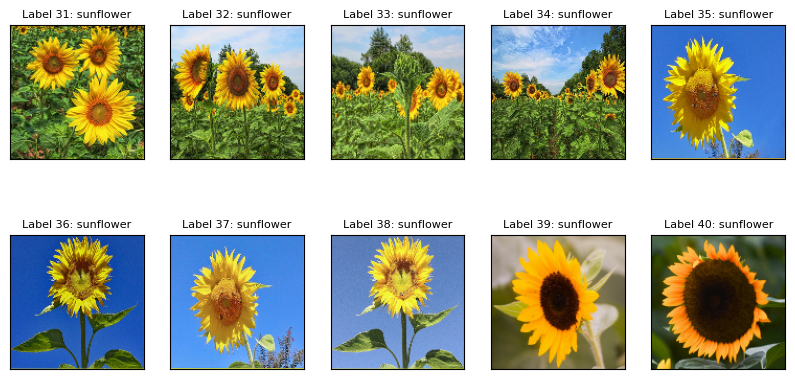

-------------------------------------------10 ảnh sunflower xấu test dự đoán---------------------------------------------------------


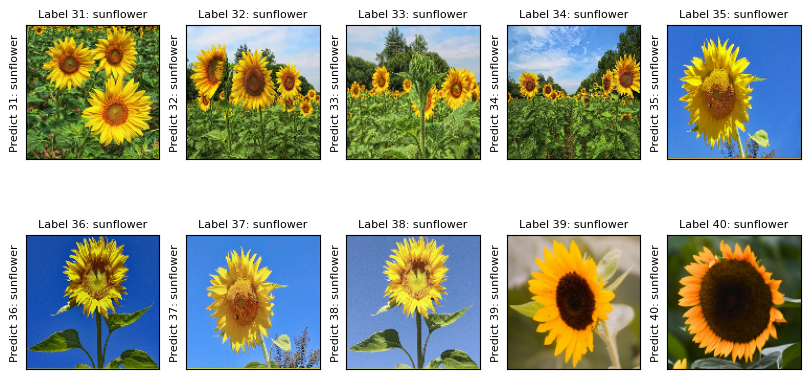

Kết quả dự đoán 10 hình sunflower xấu test
Độ chính xác dự đoán hoa sunflower của 10 hình xấu test:  100.0 %


In [46]:




fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_dep_label_img.index('sunflower')
Z_test_dep_label_sunflower = Z_test_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh sunflower xấu test đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh sunflower xấu test dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_test_dep_sunflower = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_dep_image = flower_pre_test_dep[i-1+index_type]
    y_pre_test_dep_sunflower.append(y_pre_test_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_test_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình sunflower xấu test')
accuracy_sunflower = 0
for i in range (0, len(Z_test_dep_label_sunflower)):
    if Z_test_dep_label_sunflower[i] == y_pre_test_dep_sunflower[i]:
        accuracy_sunflower += 1
accuracy_sunflower = accuracy_sunflower/len(Z_test_dep_label_sunflower)*100
print('Độ chính xác dự đoán hoa sunflower của 10 hình xấu test: ', accuracy_sunflower, '%')



# Tulip Test

-------------------------------------------10 ảnh tulip xấu test đầu vào---------------------------------------------------------


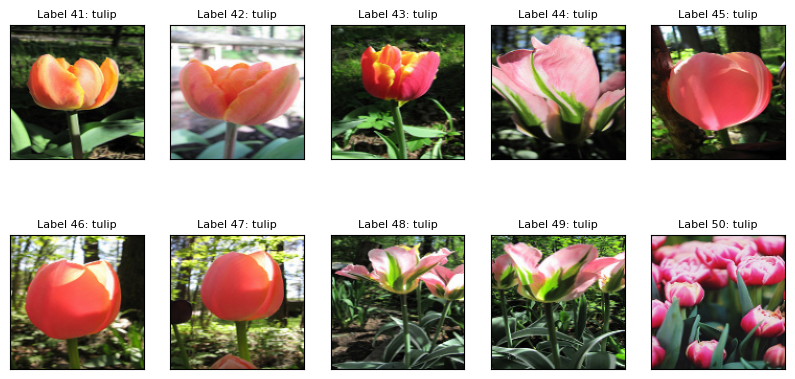

-------------------------------------------10 ảnh tulip xấu test dự đoán---------------------------------------------------------


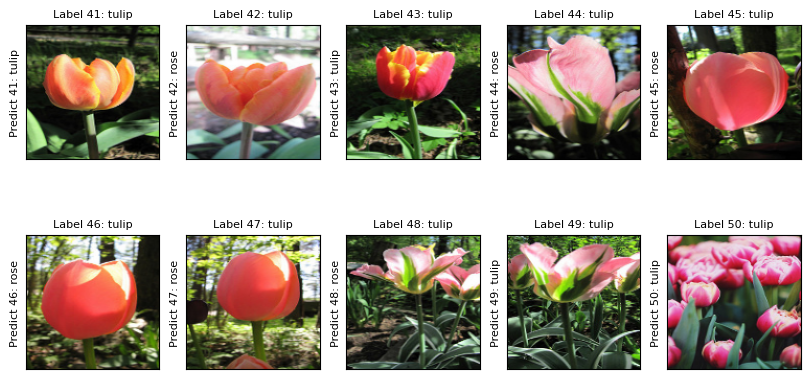

Kết quả dự đoán 10 hình tulip xấu test
Độ chính xác dự đoán hoa tulip của 10 hình xấu test:  40.0 %


In [47]:




fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_test_dep_label_img.index('tulip')
Z_test_dep_label_tulip = Z_test_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh tulip xấu test đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh tulip xấu test dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_test_dep_tulip = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_test_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_test_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_test_dep_image = flower_pre_test_dep[i-1+index_type]
    y_pre_test_dep_tulip.append(y_pre_test_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_test_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình tulip xấu test')
accuracy_tulip = 0
for i in range (0, len(Z_test_dep_label_tulip)):
    if Z_test_dep_label_tulip[i] == y_pre_test_dep_tulip[i]:
        accuracy_tulip += 1
accuracy_tulip = accuracy_tulip/len(Z_test_dep_label_tulip)*100
print('Độ chính xác dự đoán hoa tulip của 10 hình xấu test: ', accuracy_tulip, '%')




# Kiểm thử hình thực tế từ trên mạng

Chuan bi du lieu

In [48]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

Daisy_path_real_dep = '10 anh thuc te\\daisy_dep'
Dandelion_path_real_dep = '10 anh thuc te\\dandelion_dep'
Rose_path_real_dep = '10 anh thuc te\\rose_dep'
Sunflower_path_real_dep = '10 anh thuc te\\sunflower_dep'
Tulip_path_real_dep = '10 anh thuc te\\tulip_dep'


# Lấy ra từng ảnh loại hoa

X_real_dep_array_img = [] # Danh sách ma trận điểm ảnh
Z_real_dep_label_img = [] # Danh sách chưa nhãn của ảnh

# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_train_test_data_img(flower_type, path_folder_flower):
    X_type_flower = []
    Y_type_flower = []
    for img in os.listdir(path_folder_flower):
        #Lấy ra các tên loại hoa flower_type, img ảnh có ở file
        label = assign_label(img, flower_type)
        
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_real_dep_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Z_real_dep_label_img.append(str(label)) # Lấy ra tên loại hoa tương ứng với ảnh
        
        X_type_flower.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Y_type_flower.append(str(label))
    print('Số lượng loại hoa', flower_type, 'thực tế là: ', len(X_type_flower))

# Lấy ra số lượng hoa từng loại
make_train_test_data_img('daisy',Daisy_path_real_dep)
make_train_test_data_img('dandelion',Dandelion_path_real_dep)
make_train_test_data_img('rose',Rose_path_real_dep)
make_train_test_data_img('sunflower',Sunflower_path_real_dep)
make_train_test_data_img('tulip',Tulip_path_real_dep)

print('Tổng số lượng các loại hoa thực tế: ', len(X_real_dep_array_img))
print('Nhãn hoa của từng ảnh thực tế: ',Z_real_dep_label_img)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_real_dep = le.fit_transform(Z_real_dep_label_img) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_real_dep = to_categorical(Y_real_dep, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X_real_dep = np.array(X_real_dep_array_img) # ma trận điểm ảnh của từng ảnh
X_real_dep = X_real_dep/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào thực tế: ', X_real_dep)
print('Nhãn thực tế: ', Y_real_dep)

Số lượng loại hoa daisy thực tế là:  10
Số lượng loại hoa dandelion thực tế là:  10
Số lượng loại hoa rose thực tế là:  10
Số lượng loại hoa sunflower thực tế là:  10
Số lượng loại hoa tulip thực tế là:  10
Tổng số lượng các loại hoa thực tế:  50
Nhãn hoa của từng ảnh thực tế:  ['daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip']
Đầu vào thực tế:  [[[[0.19607843 0.65490196 0.43529412]
   [0.22745098 0.71372549 0.51764706]
   [0.12156863 0.65882353 0.34117647]
   ...
   [0.14901961 0.35686275 0.28235294]
   [0.01960784 0.141176

# 10 anh dep thuc te

# Daisy Real:


In [49]:
# Kiểm thử lại với tệp dữ liệu huấn luyện
y_pre_real_dep = model.predict(X_real_dep)
predict_real_dep = np.argmax(y_pre_real_dep, axis=1) # trả về vị trí có giá trị max - loại hoa tại ảnh đó
# y_real
flower_pre_real_dep = []
for i in predict_real_dep:
    if i == 0:
        flower_pre_real_dep.append('daisy')
    elif i == 1:
        flower_pre_real_dep.append('dandelion')
    elif i == 2:
        flower_pre_real_dep.append('rose')
    elif i == 3:
        flower_pre_real_dep.append('sunflower')
    else:
        flower_pre_real_dep.append('tulip')
# Sai số CE khi kiểm thử dữ liệu thực tế

# Chuyển Z_real_label_img về số nguyên
Z_real_dep_num = []
for i in Z_real_dep_label_img:
    if i == 'daisy':
        Z_real_dep_num.append(0)
    if i == 'dandelion':
        Z_real_dep_num.append(1)
    if i == 'rose':
        Z_real_dep_num.append(2)
    if i == 'sunflower':
        Z_real_dep_num.append(3)
    if i == 'tulip':
        Z_real_dep_num.append(4)
print(Z_real_dep_num)
s_ce = 0
for j in range(0, 10):
    s_ce += -np.log(y_pre_real_dep[j][Z_real_dep_num[j]])*1
print('Sai số CE mô hình dữ liệu thực tế: ', s_ce/100)

1/2 [==============>...............] - ETA: 0s

2/2 [==============================] - 0s 158ms/step
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4]
Sai số CE mô hình dữ liệu thực tế:  0.00883933883800637


-------------------------------------------10 ảnh daisy đẹp thực tế đầu vào---------------------------------------------------------


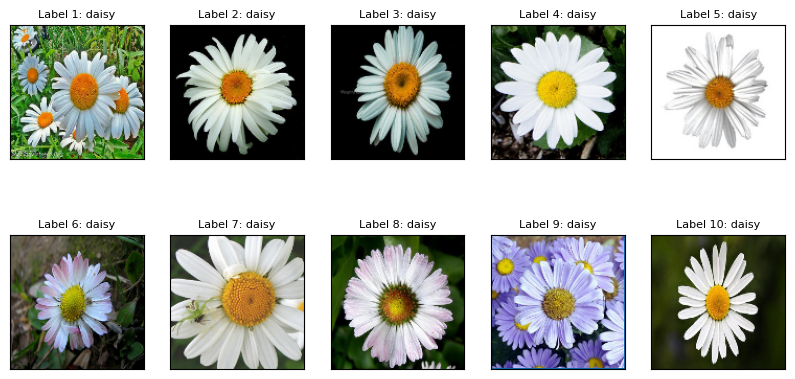

-------------------------------------------------10 ảnh daisy đẹp thực tế dự đoán-------------------------------------------------------


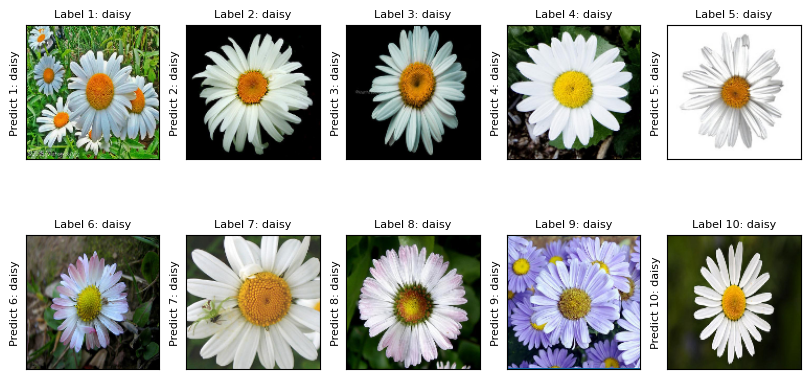

Kết quả dự đoán 10 hình daisy thực tế
Độ chính xác dự đoán hoa daisy của 10 hình thực tế:  100.0 %


In [50]:
fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_dep_label_img.index('daisy')
Z_real_dep_label_daisy = Z_real_dep_label_img[index_type:10]

y_pre_real_dep_daisy = []
print('-------------------------------------------10 ảnh daisy đẹp thực tế đầu vào---------------------------------------------------------')
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_real_dep_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()

#### predict
print('-------------------------------------------------10 ảnh daisy đẹp thực tế dự đoán-------------------------------------------------------')
fig = plt.figure(figsize=(10, 5))

y_pre_real_dep_daisy = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_real_dep_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_dep_image = flower_pre_real_dep[i-1]
    y_pre_real_dep_daisy.append(y_pre_real_dep_image)
    plt.ylabel('Predict {}: {}'.format(i, y_pre_real_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình daisy thực tế')
accuracy_daisy = 0
for i in range (0, 10):
    if Z_real_dep_label_daisy[i] == y_pre_real_dep_daisy[i]:
        accuracy_daisy += 1
accuracy_daisy = accuracy_daisy/len(Z_real_dep_label_daisy)*100
print('Độ chính xác dự đoán hoa daisy của 10 hình thực tế: ', accuracy_daisy, '%')

# Rose Real

-------------------------------------------10 ảnh rose đẹp thực tế đầu vào---------------------------------------------------------


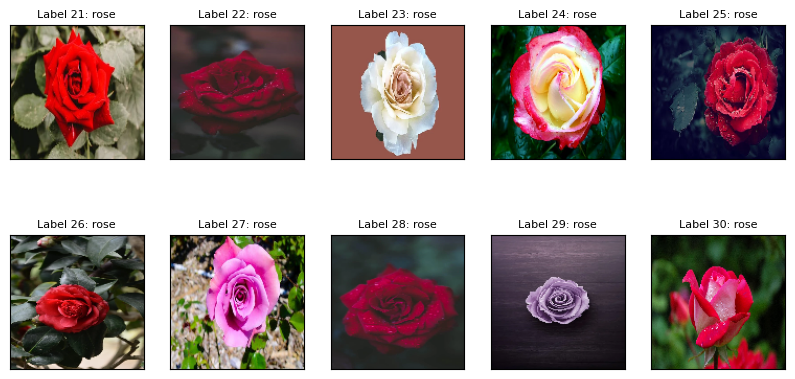

-------------------------------------------10 ảnh rose đẹp thực tế dự đoán---------------------------------------------------------


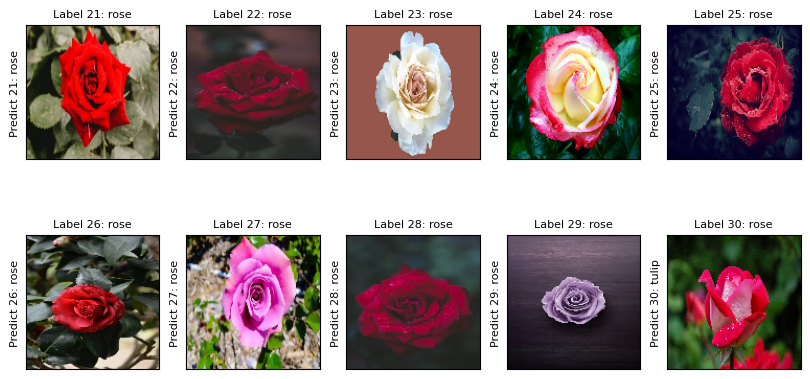

Kết quả dự đoán 10 hình rose thực tế
Độ chính xác dự đoán hoa rose của 10 hình thực tế:  90.0 %


In [72]:

fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_dep_label_img.index('rose')
Z_real_dep_label_rose = Z_real_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh rose đẹp thực tế đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh rose đẹp thực tế dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_real_dep_rose = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_dep_image = flower_pre_real_dep[i-1+index_type]
    y_pre_real_dep_rose.append(y_pre_real_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_real_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình rose thực tế')
accuracy_rose = 0
for i in range (0, len(Z_real_dep_label_rose)):
    if Z_real_dep_label_rose[i] == y_pre_real_dep_rose[i]:
        accuracy_rose += 1
accuracy_rose = accuracy_rose/len(Z_real_dep_label_rose)*100
print('Độ chính xác dự đoán hoa rose của 10 hình thực tế: ', accuracy_rose, '%')


# Dandelion Real

-------------------------------------------10 ảnh dandelion đẹp thực tế đầu vào---------------------------------------------------------


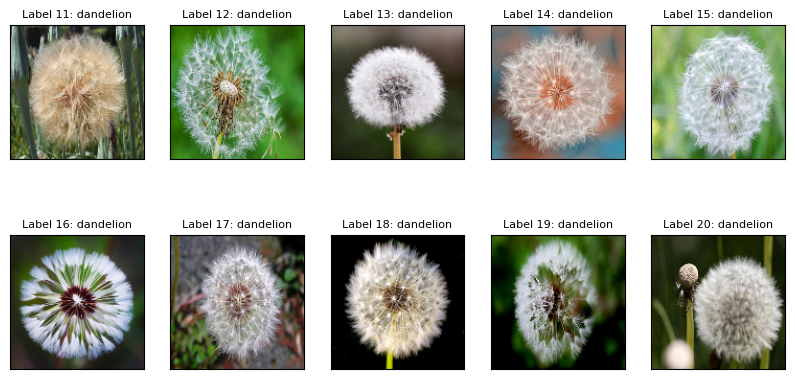

-------------------------------------------10 ảnh dandelion đẹp thực tế dự đoán---------------------------------------------------------


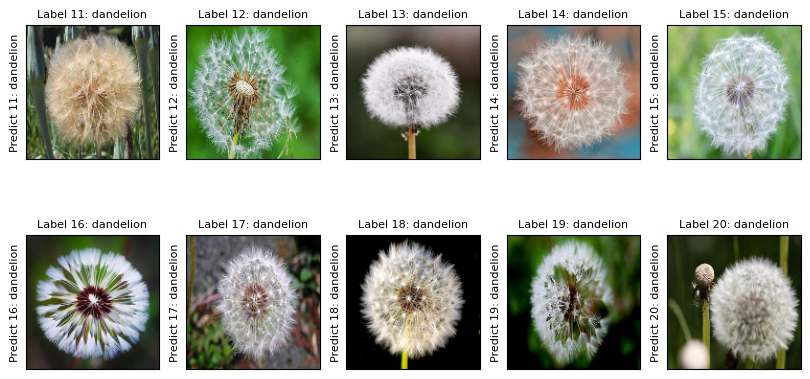

Kết quả dự đoán 10 hình dandelion thực tế
Độ chính xác dự đoán hoa dandelion của 10 hình thực tế:  100.0 %


In [52]:

fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_dep_label_img.index('dandelion')
Z_real_dep_label_dandelion = Z_real_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh dandelion đẹp thực tế đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh dandelion đẹp thực tế dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_real_dep_dandelion = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_dep_image = flower_pre_real_dep[i-1+index_type]
    y_pre_real_dep_dandelion.append(y_pre_real_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_real_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình dandelion thực tế')
accuracy_dandelion = 0
for i in range (0, len(Z_real_dep_label_dandelion)):
    if Z_real_dep_label_dandelion[i] == y_pre_real_dep_dandelion[i]:
        accuracy_dandelion += 1
accuracy_dandelion = accuracy_dandelion/len(Z_real_dep_label_dandelion)*100
print('Độ chính xác dự đoán hoa dandelion của 10 hình thực tế: ', accuracy_dandelion, '%')



# Sunflower Real

-------------------------------------------10 ảnh sunflower đẹp thực tế đầu vào---------------------------------------------------------


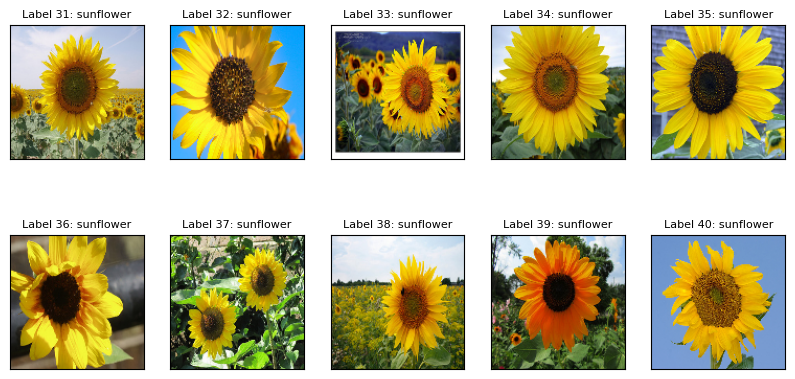

-------------------------------------------10 ảnh sunflower đẹp thực tế dự đoán---------------------------------------------------------


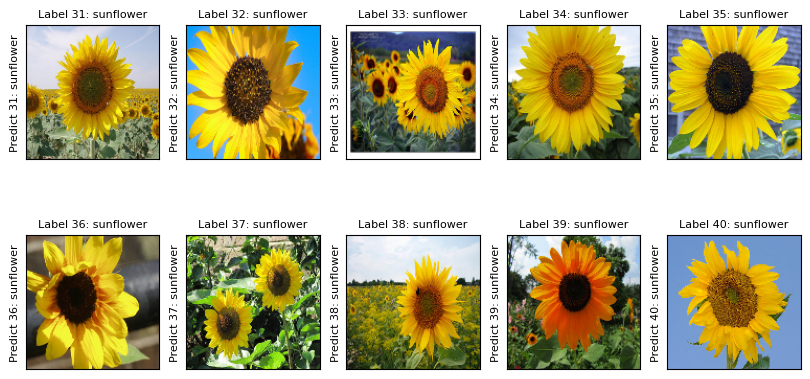

Kết quả dự đoán 10 hình sunflower thực tế
Độ chính xác dự đoán hoa sunflower của 10 hình thực tế:  100.0 %


In [71]:

fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_dep_label_img.index('sunflower')
Z_real_dep_label_sunflower = Z_real_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh sunflower đẹp thực tế đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh sunflower đẹp thực tế dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_real_dep_sunflower = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_dep_image = flower_pre_real_dep[i-1+index_type]
    y_pre_real_dep_sunflower.append(y_pre_real_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_real_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình sunflower thực tế')
accuracy_sunflower = 0
for i in range (0, len(Z_real_dep_label_sunflower)):
    if Z_real_dep_label_sunflower[i] == y_pre_real_dep_sunflower[i]:
        accuracy_sunflower += 1
accuracy_sunflower = accuracy_sunflower/len(Z_real_dep_label_sunflower)*100
print('Độ chính xác dự đoán hoa sunflower của 10 hình thực tế: ', accuracy_sunflower, '%')



# Tulip

-------------------------------------------10 ảnh tulip đẹp thực tế đầu vào---------------------------------------------------------


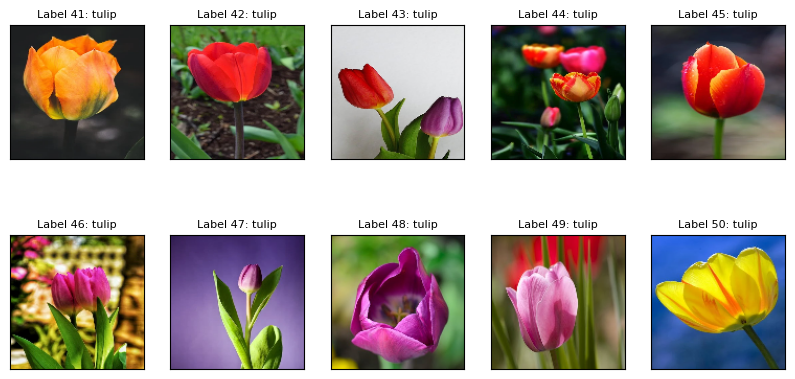

-------------------------------------------10 ảnh tulip đẹp thực tế dự đoán---------------------------------------------------------


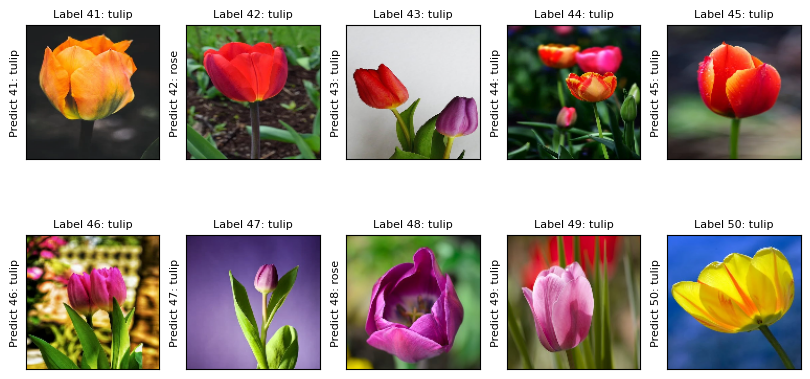

Kết quả dự đoán 10 hình tulip thực tế
Độ chính xác dự đoán hoa tulip của 10 hình thực tế:  80.0 %


In [54]:

fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_dep_label_img.index('tulip')
Z_real_dep_label_tulip = Z_real_dep_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh tulip đẹp thực tế đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh tulip đẹp thực tế dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_real_dep_tulip = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_dep_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_dep_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_dep_image = flower_pre_real_dep[i-1+index_type]
    y_pre_real_dep_tulip.append(y_pre_real_dep_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_real_dep_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình tulip thực tế')
accuracy_tulip = 0
for i in range (0, len(Z_real_dep_label_tulip)):
    if Z_real_dep_label_tulip[i] == y_pre_real_dep_tulip[i]:
        accuracy_tulip += 1
accuracy_tulip = accuracy_tulip/len(Z_real_dep_label_tulip)*100
print('Độ chính xác dự đoán hoa tulip của 10 hình thực tế: ', accuracy_tulip, '%')



# 10 anh xau thuc te


chuan bi du lieu 

In [55]:

# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

Daisy_path_real_xau = '10 anh thuc te\\daisy_xau'
Dandelion_path_real_xau = '10 anh thuc te\dandelion_xau'
Rose_path_real_xau = '10 anh thuc te\\rose_xau'
Sunflower_path_real_xau = '10 anh thuc te\\sunflower_xau'
Tulip_path_real_xau = '10 anh thuc te\\tulip_xau'


# Lấy ra từng ảnh loại hoa

X_real_xau_array_img = [] # Danh sách ma trận điểm ảnh
Z_real_xau_label_img = [] # Danh sách chưa nhãn của ảnh

# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_train_test_data_img(flower_type, path_folder_flower):
    X_type_flower = []
    Y_type_flower = []
    for img in os.listdir(path_folder_flower):
        #Lấy ra các tên loại hoa flower_type, img ảnh có ở file
        label = assign_label(img, flower_type)
        
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_real_xau_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Z_real_xau_label_img.append(str(label)) # Lấy ra tên loại hoa tương ứng với ảnh
        
        X_type_flower.append(np.array(img)) # Lấy ma trận các điểm ảnh
        Y_type_flower.append(str(label))
    print('Số lượng loại hoa', flower_type, 'thực tế là: ', len(X_type_flower))

# Lấy ra số lượng hoa từng loại
make_train_test_data_img('daisy',Daisy_path_real_xau)
make_train_test_data_img('dandelion',Dandelion_path_real_xau)
make_train_test_data_img('rose',Rose_path_real_xau)
make_train_test_data_img('sunflower',Sunflower_path_real_xau)
make_train_test_data_img('tulip',Tulip_path_real_xau)

print('Tổng số lượng các loại hoa thực tế: ', len(X_real_xau_array_img))
print('Nhãn hoa của từng ảnh thực tế: ',Z_real_xau_label_img)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_real_xau = le.fit_transform(Z_real_xau_label_img) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_real_xau = to_categorical(Y_real_xau, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X_real_xau = np.array(X_real_xau_array_img) # ma trận điểm ảnh của từng ảnh
X_real_xau = X_real_xau/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào thực tế: ', X_real_xau)
print('Nhãn thực tế: ', Y_real_xau)


Số lượng loại hoa daisy thực tế là:  10
Số lượng loại hoa dandelion thực tế là:  10
Số lượng loại hoa rose thực tế là:  10
Số lượng loại hoa sunflower thực tế là:  10
Số lượng loại hoa tulip thực tế là:  10
Tổng số lượng các loại hoa thực tế:  50
Nhãn hoa của từng ảnh thực tế:  ['daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'daisy', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'dandelion', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'rose', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'sunflower', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip', 'tulip']
Đầu vào thực tế:  [[[[0.38039216 0.39607843 0.47843137]
   [0.37647059 0.39215686 0.47058824]
   [0.34509804 0.36862745 0.43529412]
   ...
   [0.56470588 0.57647059 0.61960784]
   [0.56470588 0.576470

In [80]:
# Kiểm thử lại với tệp dữ liệu huấn luyện
y_pre_real_xau = model.predict(X_real_xau)
print(y_pre_real_xau)
predict_real_xau = np.argmax(y_pre_real_xau, axis=1) # trả về vị trí có giá trị max - loại hoa tại ảnh đó
# y_real
flower_pre_real_xau = []
for i in predict_real_xau:
    if i == 0:
        flower_pre_real_xau.append('daisy')
    elif i == 1:
        flower_pre_real_xau.append('dandelion')
    elif i == 2:
        flower_pre_real_xau.append('rose')
    elif i == 3:
        flower_pre_real_xau.append('sunflower')
    else:
        flower_pre_real_xau.append('tulip')
# Sai số CE khi kiểm thử dữ liệu thực tế

# Chuyển Z_real_label_img về số nguyên
Z_real_xau_num = []
for i in Z_real_xau_label_img:
    if i == 'daisy':
        Z_real_xau_num.append(0)
    if i == 'dandelion':
        Z_real_xau_num.append(1)
    if i == 'rose':
        Z_real_xau_num.append(2)
    if i == 'sunflower':
        Z_real_xau_num.append(3)
    if i == 'tulip':
        Z_real_xau_num.append(4)
print(Z_real_xau_num)
s_ce = 0
for j in range(0, 10):
    s_ce += -np.log(y_pre_real_xau[j][Z_real_xau_num[j]])*1
print('Sai số CE mô hình dữ liệu thực tế: ', s_ce/100)


2/2 [==============================] - 0s 92ms/step
[[8.69977653e-01 1.01504531e-02 1.07271977e-01 4.29812178e-04
  1.21701574e-02]
 [9.96810973e-01 1.23161997e-03 1.62069558e-03 6.73080649e-06
  3.29981471e-04]
 [1.02599882e-01 4.29258972e-01 8.37507099e-02 5.48797054e-03
  3.78902495e-01]
 [1.37147725e-01 7.51426490e-03 8.44090879e-01 7.39744923e-04
  1.05074449e-02]
 [9.46420878e-02 4.03080374e-01 1.13830253e-01 8.49191006e-03
  3.79955351e-01]
 [7.74711609e-01 1.58657119e-01 5.94537891e-02 1.97964095e-04
  6.97958237e-03]
 [8.32132936e-01 5.47587220e-03 1.47792429e-01 4.13981790e-04
  1.41848549e-02]
 [9.90967810e-01 4.86471131e-03 3.92267061e-03 7.11845496e-05
  1.73590510e-04]
 [1.37349322e-01 1.20860115e-01 2.84971416e-01 4.40040231e-03
  4.52418745e-01]
 [5.33510208e-01 4.60083783e-01 2.09707511e-03 4.36075585e-04
  3.87294078e-03]
 [1.10753141e-01 9.95645672e-02 7.55701780e-01 7.55932042e-03
  2.64212843e-02]
 [1.09486870e-01 8.03006530e-01 3.46174538e-02 1.91615359e-03
  5.09

# Daisy Real

-------------------------------------------10 ảnh daisy xấu thực tế đầu vào---------------------------------------------------------


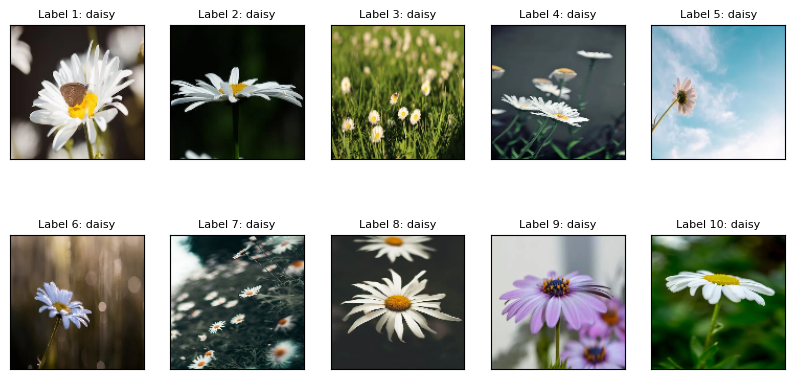

-------------------------------------------------10 ảnh daisy xấu thực tế dự đoán-------------------------------------------------------


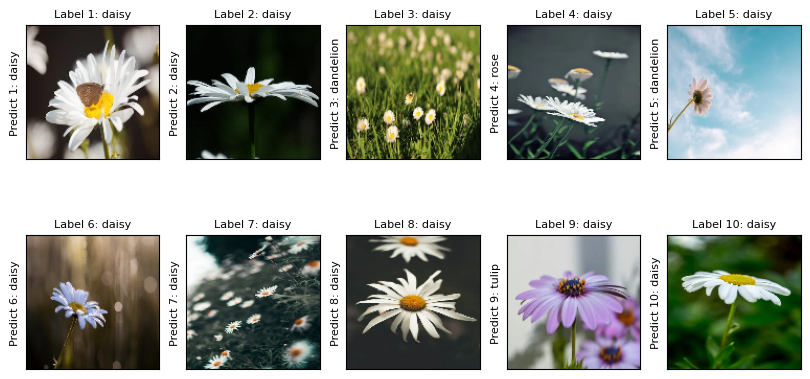

Kết quả dự đoán 10 hình daisy thực tế
Độ chính xác dự đoán hoa daisy của 10 hình thực tế:  60.0 %


In [70]:


fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_xau_label_img.index('daisy')
Z_real_xau_label_daisy = Z_real_xau_label_img[index_type:10]

y_pre_real_xau_daisy = []
print('-------------------------------------------10 ảnh daisy xấu thực tế đầu vào---------------------------------------------------------')
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_real_xau_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()

#### predict
print('-------------------------------------------------10 ảnh daisy xấu thực tế dự đoán-------------------------------------------------------')
fig = plt.figure(figsize=(10, 5))

y_pre_real_xau_daisy = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_real_xau_label_img[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_xau_image = flower_pre_real_xau[i-1]
    y_pre_real_xau_daisy.append(y_pre_real_xau_image)
    plt.ylabel('Predict {}: {}'.format(i, y_pre_real_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình daisy thực tế')
accuracy_daisy = 0
for i in range (0, 10):
    if Z_real_xau_label_daisy[i] == y_pre_real_xau_daisy[i]:
        accuracy_daisy += 1
accuracy_daisy = accuracy_daisy/len(Z_real_xau_label_daisy)*100
print('Độ chính xác dự đoán hoa daisy của 10 hình thực tế: ', accuracy_daisy, '%')
 


# Rose Real

-------------------------------------------10 ảnh rose xấu thực tế đầu vào---------------------------------------------------------


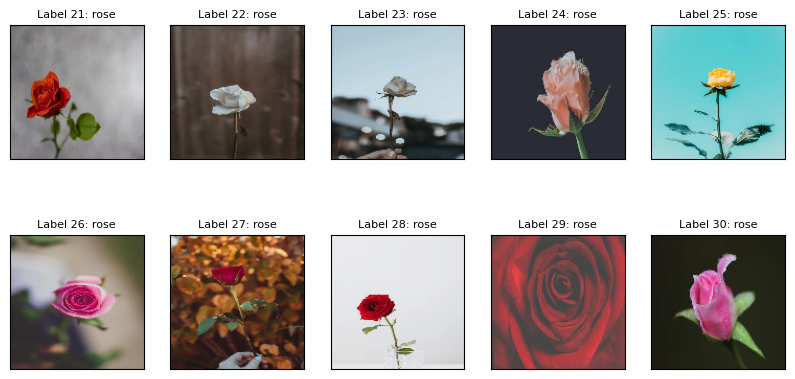

-------------------------------------------10 ảnh rose xấu thực tế dự đoán---------------------------------------------------------


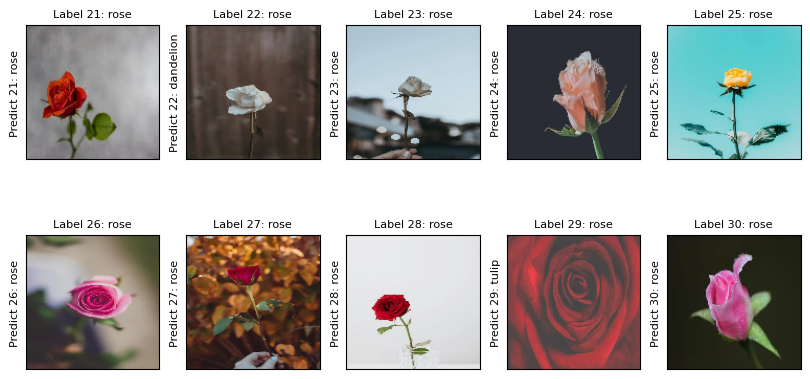

Kết quả dự đoán 10 hình rose thực tế
Độ chính xác dự đoán hoa rose của 10 hình thực tế:  80.0 %


In [69]:


fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_xau_label_img.index('rose')
Z_real_xau_label_rose = Z_real_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh rose xấu thực tế đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh rose xấu thực tế dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_real_xau_rose = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_xau_image = flower_pre_real_xau[i-1+index_type]
    y_pre_real_xau_rose.append(y_pre_real_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_real_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình rose thực tế')
accuracy_rose = 0
for i in range (0, len(Z_real_xau_label_rose)):
    if Z_real_xau_label_rose[i] == y_pre_real_xau_rose[i]:
        accuracy_rose += 1
accuracy_rose = accuracy_rose/len(Z_real_xau_label_rose)*100
print('Độ chính xác dự đoán hoa rose của 10 hình thực tế: ', accuracy_rose, '%')

 


# Dandelion Real

-------------------------------------------10 ảnh dandelion xấu thực tế đầu vào---------------------------------------------------------


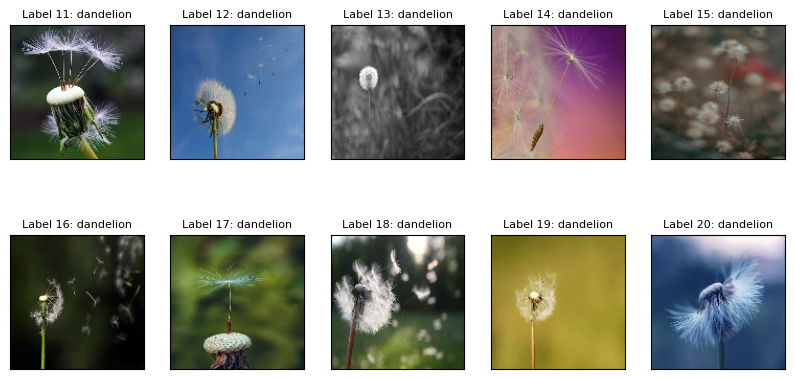

-------------------------------------------10 ảnh dandelion xấu thực tế dự đoán---------------------------------------------------------


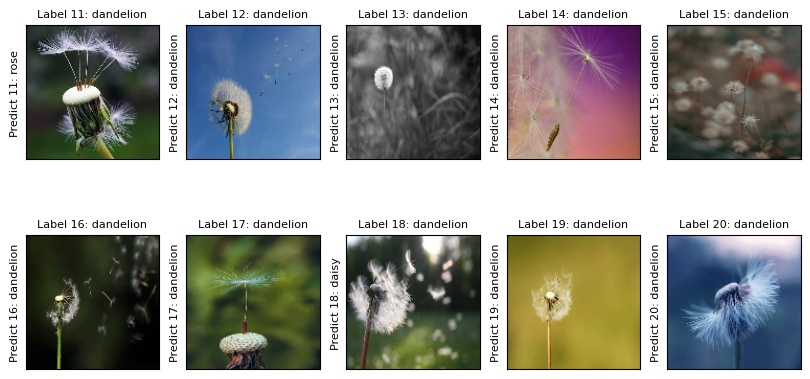

Kết quả dự đoán 10 hình dandelion xấu thực tế
Độ chính xác dự đoán hoa dandelion của 10 hình thực tế:  80.0 %


In [68]:




fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_xau_label_img.index('dandelion')
Z_real_xau_label_dandelion = Z_real_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh dandelion xấu thực tế đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh dandelion xấu thực tế dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_real_xau_dandelion = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_xau_image = flower_pre_real_xau[i-1+index_type]
    y_pre_real_xau_dandelion.append(y_pre_real_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_real_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình dandelion xấu thực tế')
accuracy_dandelion = 0
for i in range (0, len(Z_real_xau_label_dandelion)):
    if Z_real_xau_label_dandelion[i] == y_pre_real_xau_dandelion[i]:
        accuracy_dandelion += 1
accuracy_dandelion = accuracy_dandelion/len(Z_real_xau_label_dandelion)*100
print('Độ chính xác dự đoán hoa dandelion của 10 hình thực tế: ', accuracy_dandelion, '%')


 


# Sunflower Real

-------------------------------------------10 ảnh sunflower xấu thực tế đầu vào---------------------------------------------------------


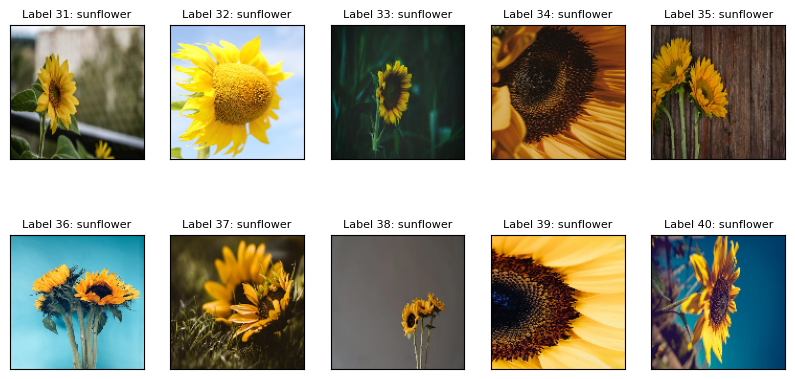

-------------------------------------------10 ảnh sunflower xấu thực tế dự đoán---------------------------------------------------------


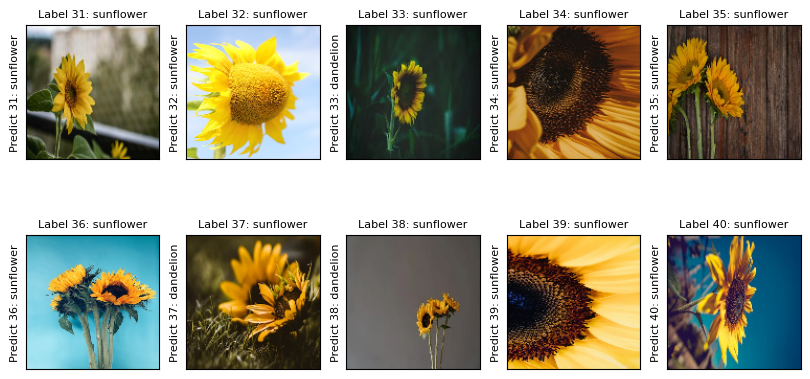

Kết quả dự đoán 10 hình sunflower xấu thực tế
Độ chính xác dự đoán hoa sunflower của 10 hình thực tế:  70.0 %


In [67]:

fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_xau_label_img.index('sunflower')
Z_real_xau_label_sunflower = Z_real_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh sunflower xấu thực tế đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh sunflower xấu thực tế dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_real_xau_sunflower = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_xau_image = flower_pre_real_xau[i-1+index_type]
    y_pre_real_xau_sunflower.append(y_pre_real_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_real_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình sunflower xấu thực tế')
accuracy_sunflower = 0
for i in range (0, len(Z_real_xau_label_sunflower)):
    if Z_real_xau_label_sunflower[i] == y_pre_real_xau_sunflower[i]:
        accuracy_sunflower += 1
accuracy_sunflower = accuracy_sunflower/len(Z_real_xau_label_sunflower)*100
print('Độ chính xác dự đoán hoa sunflower của 10 hình thực tế: ', accuracy_sunflower, '%')


 


# Tulip Real

-------------------------------------------10 ảnh tulip xấu thực tế đầu vào---------------------------------------------------------


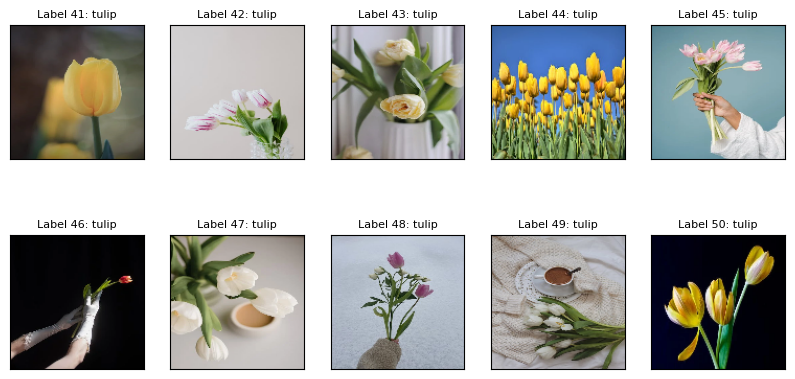

-------------------------------------------10 ảnh tulip xấu thực tế dự đoán---------------------------------------------------------


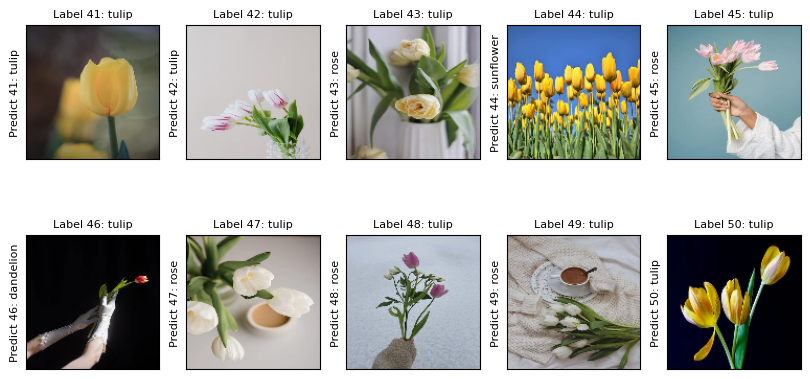

Kết quả dự đoán 20 hình tulip thực tế
Độ chính xác dự đoán hoa tulip của 10 hình thực tế:  30.0 %


In [66]:



fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
index_type = Z_real_xau_label_img.index('tulip')
Z_real_xau_label_tulip = Z_real_xau_label_img[index_type:index_type+10]
print('-------------------------------------------10 ảnh tulip xấu thực tế đầu vào---------------------------------------------------------')

for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()
print('-------------------------------------------10 ảnh tulip xấu thực tế dự đoán---------------------------------------------------------')


fig = plt.figure(figsize=(10, 5))
y_pre_real_xau_tulip = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_real_xau_array_img[i-1 + index_type]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i+index_type, Z_real_xau_label_img[i-1+index_type]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    y_pre_real_xau_image = flower_pre_real_xau[i-1+index_type]
    y_pre_real_xau_tulip.append(y_pre_real_xau_image)
    plt.ylabel('Predict {}: {}'.format(i+index_type, y_pre_real_xau_image), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 20 hình tulip thực tế')
accuracy_tulip = 0
for i in range (0, len(Z_real_xau_label_tulip)):
    if Z_real_xau_label_tulip[i] == y_pre_real_xau_tulip[i]:
        accuracy_tulip += 1
accuracy_tulip = accuracy_tulip/len(Z_real_xau_label_tulip)*100
print('Độ chính xác dự đoán hoa tulip của 10 hình thực tế: ', accuracy_tulip, '%')


 


# 10 ảnh đẹp nhiều loại


In [103]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

anh_dep_nhieu_loai = '10 anh dep nhieu loai'


# Lấy ra từng ảnh loại hoa


X_nhieu_loai_dep_array_img = []
Z_nhieu_loai_dep_label = ['daisy', 'daisy', 'dandelion', 'dandelion', 'rose', 'rose', 'sunflower', 'sunflower', 'tulip', 'tulip']
# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_data_img(path_folder_flower):

    for img in os.listdir(path_folder_flower):
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_nhieu_loai_dep_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
    
# Lấy ra số lượng hoa từng loại
make_data_img(anh_dep_nhieu_loai)
print('Tổng số lượng ảnh đẹp nhiều loại là: ', len(X_nhieu_loai_dep_array_img))
print('Nhãn hoa của từng ảnh : ',Z_nhieu_loai_dep_label)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_nhieu_loai_dep = le.fit_transform(Z_nhieu_loai_dep_label) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_nhieu_loai_dep = to_categorical(Y_nhieu_loai_dep, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X2_nhieu_loai_dep_array_img = np.array(X_nhieu_loai_dep_array_img) # ma trận điểm ảnh của từng ảnh
X2_nhieu_loai_dep_array_img = X2_nhieu_loai_dep_array_img/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào thực tế ảnh đẹp nhiều loại: ', X2_nhieu_loai_dep_array_img)
print('Nhãn thực tế: ', Y_nhieu_loai_dep)



Tổng số lượng ảnh đẹp nhiều loại là:  10
Nhãn hoa của từng ảnh :  ['daisy', 'daisy', 'dandelion', 'dandelion', 'rose', 'rose', 'sunflower', 'sunflower', 'tulip', 'tulip']
Đầu vào thực tế ảnh đẹp nhiều loại:  [[[[0.0745098  0.11764706 0.10588235]
   [0.09019608 0.1254902  0.1254902 ]
   [0.08235294 0.16862745 0.14901961]
   ...
   [0.08627451 0.23529412 0.18823529]
   [0.08627451 0.22352941 0.18823529]
   [0.10980392 0.23921569 0.21176471]]

  [[0.07843137 0.12156863 0.10980392]
   [0.10588235 0.14509804 0.1372549 ]
   [0.09411765 0.18039216 0.16078431]
   ...
   [0.07058824 0.23921569 0.18431373]
   [0.07843137 0.23529412 0.19215686]
   [0.09803922 0.23137255 0.2       ]]

  [[0.0745098  0.12941176 0.10588235]
   [0.10196078 0.15294118 0.14509804]
   [0.10980392 0.19607843 0.18039216]
   ...
   [0.07058824 0.24705882 0.18039216]
   [0.0745098  0.24313725 0.19215686]
   [0.10588235 0.25098039 0.21176471]]

  ...

  [[0.08627451 0.30980392 0.16078431]
   [0.0745098  0.29019608 0.16078431

In [104]:
# Kiểm thử lại với tệp dữ liệu huấn luyện
y_pre_nhieu_loai_dep = model.predict(X2_nhieu_loai_dep_array_img)
predict_nhieu_loai_dep = np.argmax(y_pre_nhieu_loai_dep, axis=1) # trả về vị trí có giá trị max - loại hoa tại ảnh đó
# y_real
flower_pre_nhieu_loai_dep = []
for i in predict_nhieu_loai_dep:
    if i == 0:
        flower_pre_nhieu_loai_dep.append('daisy')
    elif i == 1:
        flower_pre_nhieu_loai_dep.append('dandelion')
    elif i == 2:
        flower_pre_nhieu_loai_dep.append('rose')
    elif i == 3:
        flower_pre_nhieu_loai_dep.append('sunflower')
    else:
        flower_pre_nhieu_loai_dep.append('tulip')
print('y_pre_nhieu_loai_dep', y_pre_nhieu_loai_dep)
print('flower_pre_nhieu_loai_dep', flower_pre_nhieu_loai_dep)
# Chuyển Z_real_label_img về số nguyên
Z_nhieu_loai_dep_num = []
for i in Z_nhieu_loai_dep_label:
    if i == 'daisy':
        Z_nhieu_loai_dep_num.append(0)
    if i == 'dandelion':
        Z_nhieu_loai_dep_num.append(1)
    if i == 'rose':
       Z_nhieu_loai_dep_num.append(2)
    if i == 'sunflower':
        Z_nhieu_loai_dep_num.append(3)
    if i == 'tulip':
        Z_nhieu_loai_dep_num.append(4)
print('Z_nhieu_loai_dep_num_label', Z_nhieu_loai_dep_num)
s_ce = 0
for j in range(0, 10):
    s_ce += -np.log(y_pre_nhieu_loai_dep[j][Z_nhieu_loai_dep_num[j]])*1
print('Sai số CE mô hình dữ liệu thực tế: ', s_ce/100)

1/1 [==============================] - 0s 86ms/step
y_pre_nhieu_loai_dep [[9.05228257e-01 3.74617353e-02 4.69971225e-02 8.14707659e-04
  9.49815754e-03]
 [8.64642799e-01 8.98967013e-02 2.06977203e-02 2.26028520e-03
  2.25024372e-02]
 [2.64689501e-04 9.98751163e-01 8.18598666e-04 3.29128670e-05
  1.32595087e-04]
 [3.03737577e-02 9.51783299e-01 1.23069631e-02 7.87961530e-04
  4.74802265e-03]
 [1.82350341e-03 4.64932149e-04 5.06193399e-01 7.93746766e-03
  4.83580709e-01]
 [1.47679367e-03 1.36056135e-03 8.89353395e-01 1.72395038e-03
  1.06085375e-01]
 [1.96944326e-02 7.64510855e-02 6.15456328e-03 8.75648797e-01
  2.20511556e-02]
 [7.62668264e-04 2.18289085e-02 9.70779161e-04 9.64514673e-01
  1.19230365e-02]
 [1.12361170e-03 2.44497806e-01 6.18452847e-01 3.02610709e-03
  1.32899523e-01]
 [2.10587110e-04 1.24693674e-03 9.44964029e-03 3.03131957e-02
  9.58779693e-01]]
flower_pre_nhieu_loai_dep ['daisy', 'daisy', 'dandelion', 'dandelion', 'rose', 'rose', 'sunflower', 'sunflower', 'rose', 'tuli

-------------------------------------------10 ảnh đẹp nhiều loại đầu vào---------------------------------------------------------


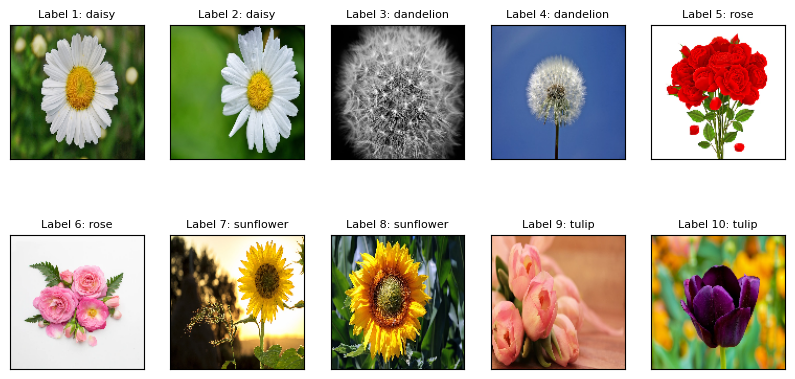

-------------------------------------------------10 ảnh đẹp nhiều loại dự đoán-------------------------------------------------------


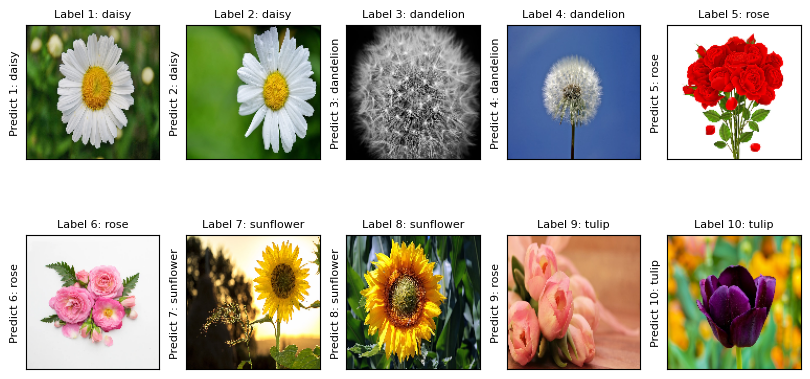

Kết quả dự đoán 10 hình đẹp có nhiều loại là
Độ chính xác 10 ảnh đẹp nhiều loại là:  90.0 %


In [115]:


fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
print('-------------------------------------------10 ảnh đẹp nhiều loại đầu vào---------------------------------------------------------')
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_nhieu_loai_dep_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_nhieu_loai_dep_label[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()

#### predict
print('-------------------------------------------------10 ảnh đẹp nhiều loại dự đoán-------------------------------------------------------')
fig = plt.figure(figsize=(10, 5))

y_pre_nhieu_loai_dep = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_nhieu_loai_dep_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_nhieu_loai_dep_label[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    plt.ylabel('Predict {}: {}'.format(i, flower_pre_nhieu_loai_dep[i-1]), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình đẹp có nhiều loại là')

acc_nhieu_loai_dep = 0
for i in range (0, len(flower_pre_nhieu_loai_dep)):
    if flower_pre_nhieu_loai_dep[i] == Z_nhieu_loai_dep_label[i]:
        acc_nhieu_loai_dep += 1
print('Độ chính xác 10 ảnh đẹp nhiều loại là: ', acc_nhieu_loai_dep/len(flower_pre_nhieu_loai_dep) * 100, '%')

 


# 10 ảnh xấu nhiều loại

In [118]:
# Lấy ra từng loại hoa trong từng folder hoa tương ứng

# Lấy path folder hoa từng loại

img_size = 150

anh_xau_nhieu_loai = '10 anh xau nhieu loai'


# Lấy ra từng ảnh loại hoa


X_nhieu_loai_xau_array_img = []
Z_nhieu_loai_xau_label = ['daisy', 'daisy', 'dandelion', 'dandelion', 'rose', 'rose', 'sunflower', 'sunflower', 'tulip', 'tulip']
# Gắn  từng nhãn tương ứng ảnh loại hoa

def assign_label(img, flower_type): #img: ảnh đầu vào, flower_type: Tên loại hoa
    return flower_type

def make_data_img(path_folder_flower):

    for img in os.listdir(path_folder_flower):
        # Hàm này được sử dụng để nối các đường dẫn tệp tin hoặc thư mục với nhau. 
        # Ví dụ, nếu bạn muốn nối đường dẫn tệp tin img.jpg
        path = os.path.join(path_folder_flower, img) # trả về đường dẫn file của từng folder hoa.
        img = cv2.imread(path, cv2.IMREAD_COLOR) # Đọc ảnh
        img = cv2.resize(img, (128,128)) #Chỉnh kích thước cho cùng nhau
        
        X_nhieu_loai_xau_array_img.append(np.array(img)) # Lấy ma trận các điểm ảnh
    
# Lấy ra số lượng hoa từng loại
make_data_img(anh_xau_nhieu_loai)
print('Tổng số lượng ảnh xấu nhiều loại là: ', len(X_nhieu_loai_xau_array_img))
print('Nhãn hoa của từng ảnh : ',Z_nhieu_loai_xau_label)

# Dữ liệu ma trận Huấn luyện (one-hot)
le = LabelEncoder() # Mã hóa các loại hoa và chuyển đổi chúng thành các số nguyên (nếu Daisy xuất hiện:1, các vị trí còn lại = 0)
Y_nhieu_loai_xau = le.fit_transform(Z_nhieu_loai_xau_label) # Đưa về dạng số nguyên # quy ước: 0: daisy, 1: dandelion, 2: rose, 3: sunflower, 4: tulip  [0 0 0 ... 4 4 4]
Y_nhieu_loai_xau = to_categorical(Y_nhieu_loai_xau, 5) # Phân ra 5 loại hoa -> đưa Y ở trên về dạng vecto [x, x, x, x, x]: vd ảnh 1 là Daisy  thì ma trận [1,0,0,0,0]  index(1) = 0->daisy
# đưa về dạng ma trận so sánh 5 gt xác suất của các loại hoa
X2_nhieu_loai_xau_array_img = np.array(X_nhieu_loai_xau_array_img) # ma trận điểm ảnh của từng ảnh
X2_nhieu_loai_xau_array_img = X2_nhieu_loai_xau_array_img/255 # Giảm độ lớn giá trị ma trận  mỗi kênh màu R,G,B sẽ sử dụng 8bit để biểu diễn, tức là giá trị R, G, B nằm trong khoảng 0 - 255
# ảnh dạng trắng đen.
#X: data đầu vào
#Y: nhãn label
print('Đầu vào thực tế ảnh xấu nhiều loại: ', X2_nhieu_loai_xau_array_img)
print('Nhãn thực tế: ', Y_nhieu_loai_xau)




Tổng số lượng ảnh xấu nhiều loại là:  10
Nhãn hoa của từng ảnh :  ['daisy', 'daisy', 'dandelion', 'dandelion', 'rose', 'rose', 'sunflower', 'sunflower', 'tulip', 'tulip']
Đầu vào thực tế ảnh xấu nhiều loại:  [[[[0.82352941 0.6627451  0.4745098 ]
   [0.81568627 0.66666667 0.4745098 ]
   [0.80392157 0.65882353 0.47843137]
   ...
   [0.96470588 0.96470588 0.96470588]
   [0.96470588 0.96470588 0.96470588]
   [0.96470588 0.96470588 0.96470588]]

  [[0.82352941 0.6627451  0.4745098 ]
   [0.81568627 0.66666667 0.4745098 ]
   [0.80392157 0.65882353 0.47843137]
   ...
   [0.96470588 0.96470588 0.96470588]
   [0.96470588 0.96470588 0.96470588]
   [0.96470588 0.96470588 0.96470588]]

  [[0.81176471 0.65882353 0.47058824]
   [0.80392157 0.6627451  0.47058824]
   [0.80784314 0.6627451  0.48235294]
   ...
   [0.96470588 0.96470588 0.96470588]
   [0.96470588 0.96470588 0.96470588]
   [0.96470588 0.96470588 0.96470588]]

  ...

  [[0.03921569 0.1372549  0.19215686]
   [0.02745098 0.1372549  0.18039216

In [120]:
# Kiểm thử lại với tệp dữ liệu huấn luyện
y_pre_nhieu_loai_xau = model.predict(X2_nhieu_loai_xau_array_img)
predict_nhieu_loai_xau = np.argmax(y_pre_nhieu_loai_xau, axis=1) # trả về vị trí có giá trị max - loại hoa tại ảnh đó
# y_real
flower_pre_nhieu_loai_xau = []
for i in predict_nhieu_loai_xau:
    if i == 0:
        flower_pre_nhieu_loai_xau.append('daisy')
    elif i == 1:
        flower_pre_nhieu_loai_xau.append('dandelion')
    elif i == 2:
        flower_pre_nhieu_loai_xau.append('rose')
    elif i == 3:
        flower_pre_nhieu_loai_xau.append('sunflower')
    else:
        flower_pre_nhieu_loai_xau.append('tulip')
print('y_pre_nhieu_loai_xau', y_pre_nhieu_loai_xau)
print('flower_pre_nhieu_loai_xau', flower_pre_nhieu_loai_xau)
# Chuyển Z_real_label_img về số nguyên
Z_nhieu_loai_xau_num = []
for i in Z_nhieu_loai_xau_label:
    if i == 'daisy':
        Z_nhieu_loai_xau_num.append(0)
    if i == 'dandelion':
        Z_nhieu_loai_xau_num.append(1)
    if i == 'rose':
       Z_nhieu_loai_xau_num.append(2)
    if i == 'sunflower':
        Z_nhieu_loai_xau_num.append(3)
    if i == 'tulip':
        Z_nhieu_loai_xau_num.append(4)
print('Z_nhieu_loai_xau_num_label', Z_nhieu_loai_xau_num)
s_ce = 0
for j in range(0, 10):
    s_ce += -np.log(y_pre_nhieu_loai_xau[j][Z_nhieu_loai_xau_num[j]])*1
print('Sai số CE mô hình dữ liệu thực tế: ', s_ce/100)




1/1 [==============================] - 0s 247ms/step
y_pre_nhieu_loai_xau [[1.6796061e-01 3.7237060e-01 1.3749054e-01 2.7324108e-02 2.9485410e-01]
 [3.7803508e-02 2.8950540e-02 6.0307622e-01 6.2133633e-03 3.2395640e-01]
 [6.1349727e-02 8.8031226e-01 1.7692626e-02 9.2798827e-04 3.9717432e-02]
 [7.4013937e-03 2.7065663e-02 7.3674715e-01 3.9287559e-03 2.2485708e-01]
 [4.0477574e-02 1.1037543e-02 8.2937926e-01 1.6094727e-03 1.1749621e-01]
 [5.8301765e-04 1.8427616e-02 3.1195754e-01 4.3007461e-03 6.6473109e-01]
 [3.6691453e-03 1.0426525e-01 2.2804327e-03 8.4861952e-01 4.1165672e-02]
 [1.2019862e-03 9.4411178e-03 3.5357343e-03 9.5122081e-01 3.4600403e-02]
 [2.1748308e-05 6.4475549e-05 4.0944535e-03 4.8170480e-04 9.9533761e-01]
 [7.2414119e-04 1.2248702e-04 1.9480371e-01 4.7307083e-04 8.0387658e-01]]
flower_pre_nhieu_loai_xau ['dandelion', 'rose', 'dandelion', 'rose', 'rose', 'tulip', 'sunflower', 'sunflower', 'tulip', 'tulip']
Z_nhieu_loai_xau_num_label [0, 0, 1, 1, 2, 2, 3, 3, 4, 4]
Sai số 

-------------------------------------------10 ảnh xấu nhiều loại đầu vào---------------------------------------------------------


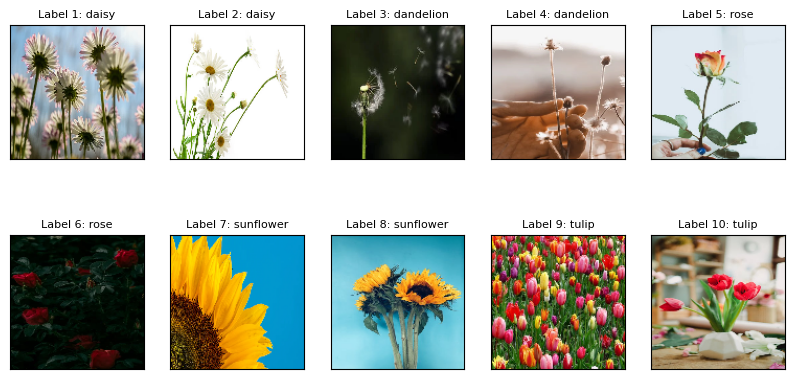

-------------------------------------------------10 ảnh xấu nhiều loại dự đoán-------------------------------------------------------


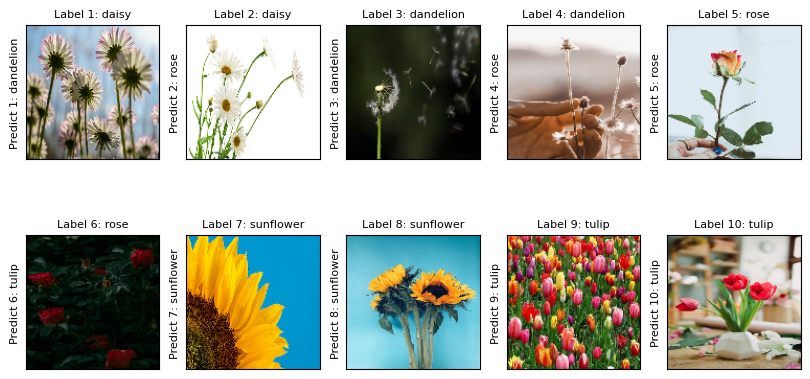

Kết quả dự đoán 10 hình xấu có nhiều loại là
Độ chính xác 10 ảnh xấu nhiều loại là:  60.0 %


In [122]:

fig = plt.figure(figsize=(10, 5))
columns = 5
rows = 2
print('-------------------------------------------10 ảnh xấu nhiều loại đầu vào---------------------------------------------------------')
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_nhieu_loai_xau_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_nhieu_loai_xau_label[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
plt.show()

#### predict
print('-------------------------------------------------10 ảnh xấu nhiều loại dự đoán-------------------------------------------------------')
fig = plt.figure(figsize=(10, 5))

y_pre_nhieu_loai_xau = []
for i in range(1, columns * rows+1):
    fig.add_subplot(rows, columns, i)
    img = X_nhieu_loai_xau_array_img[i-1]
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.title('Label {}: {}'.format(i, Z_nhieu_loai_xau_label[i-1]), fontdict={'fontsize':8} )
    plt.xticks([]) # bỏ tọa độ ở 2 trục
    plt.yticks([])
    plt.ylabel('Predict {}: {}'.format(i, flower_pre_nhieu_loai_xau[i-1]), fontdict={'fontsize':8})
plt.show()
print('Kết quả dự đoán 10 hình xấu có nhiều loại là')

acc_nhieu_loai_xau = 0
for i in range (0, len(flower_pre_nhieu_loai_xau)):
    if flower_pre_nhieu_loai_xau[i] == Z_nhieu_loai_xau_label[i]:
        acc_nhieu_loai_xau += 1
print('Độ chính xác 10 ảnh xấu nhiều loại là: ', acc_nhieu_loai_xau/len(flower_pre_nhieu_loai_xau) * 100, '%')

 


# Đánh giá

Text(0.5, 1.0, 'Sai số (Loss) khi huấn luyện')

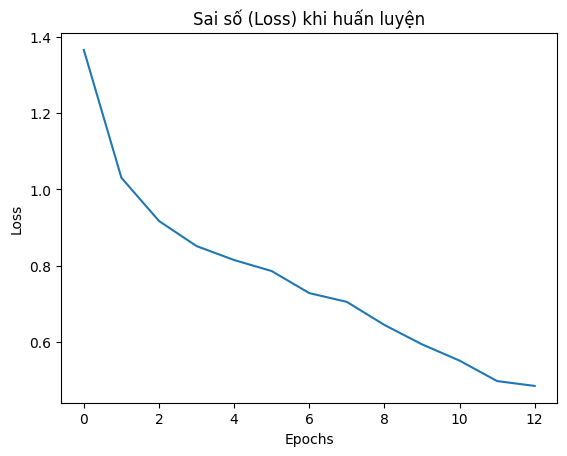

In [123]:
plt.plot(History.history['loss'])
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Sai số (Loss) khi huấn luyện')

Text(0.5, 1.0, 'Độ chính xác (Accuracy) khi mô hình huấn luyện')

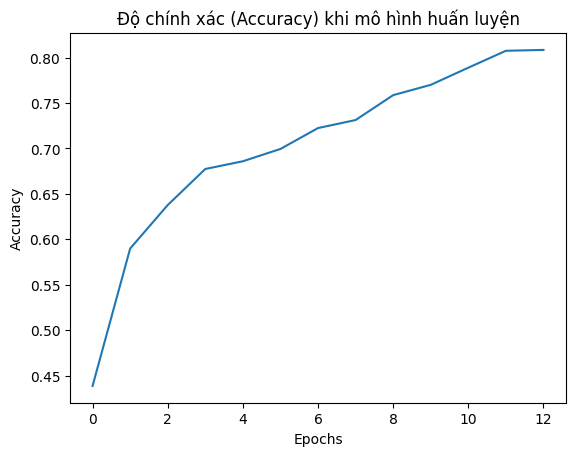

In [63]:
plt.plot(History.history['accuracy'])

plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title('Độ chính xác (Accuracy) khi mô hình huấn luyện')

Text(0.5, 1.0, 'Sai số (Loss) khi mô hình kiểm thử dữ liệu test')

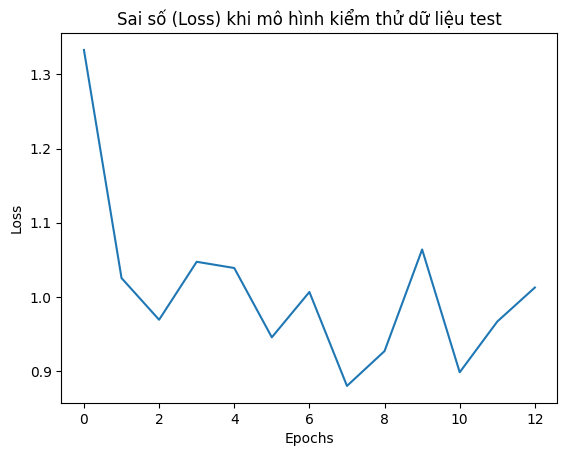

In [64]:
plt.plot(History.history['val_loss'])

plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Sai số (Loss) khi mô hình kiểm thử dữ liệu test')

Text(0.5, 1.0, 'Độ chính xác (val_accuracy) khi mô hình kiểm thử dữ liệu test')

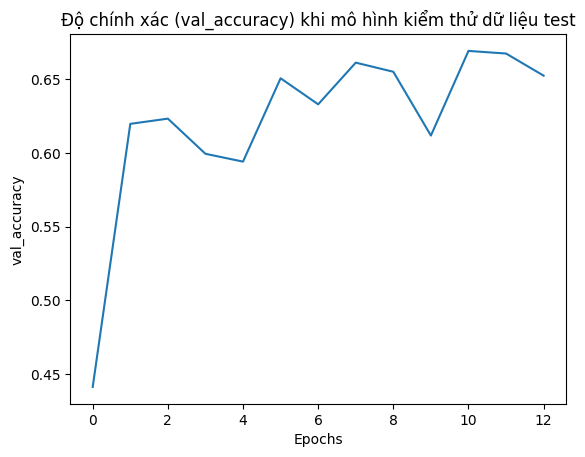

In [65]:
plt.plot(History.history['val_accuracy'])

plt.xlabel('Epochs')
plt.ylabel('val_accuracy')
plt.title('Độ chính xác (val_accuracy) khi mô hình kiểm thử dữ liệu test')